In [1]:
%load_ext autoreload
%autoreload 2
import os
import glob
import pickle
import matplotlib.pyplot as plt
import numpy as np

In [2]:
%matplotlib inline
fig_width = 15

from aSPEM import Analysis
import bayesianchangepoint as bcp

In [3]:
list_sujet = ['s01','s02','s03','s04','s05','s06','s07','s08','s09','s10','s11','s12']
nb_sujet = len(list_sujet)

In [4]:
liste = []
for fname in glob.glob('../data/*pkl'):
    a = fname.split('/')[2].split('.')[0].split('_')
    liste.append(a)
            
BET = {}
for x in range(len(liste)) :
    if liste[x][0]=='bet' and liste[x][1] in list_sujet:
        a = '../data/%s_%s_%s_%s.pkl'%(liste[x][0], liste[x][1],liste[x][2],liste[x][3])
        with open(a, 'rb') as fichier :
            b = pickle.load(fichier, encoding='latin1')
            b['observer'] = liste[x][1]
            BET[liste[x][1]] = b

In [5]:
e = Analysis(observer='s01', mode='eyeMvt')
Full = e.Full_list(modes_bcp=None)

# Scaling Data

In [6]:
file = os.path.join('parametre', 'Data_Scaling.pkl')
with open(file, 'rb') as fichier:
    new_data = pickle.load(fichier, encoding='latin1')

In [7]:
new_bet_full = new_data['new_bet_full']
new_bet_sujet = new_data['new_bet_sujet']
new_va_full = new_data['new_va_full']
new_va_sujet = new_data['new_va_sujet']

# Variation de h

In [8]:
file = os.path.join('parametre/list_h', 'list_h_TAU.pkl')
with open(file, 'rb') as fichier:
    liste_h = pickle.load(fichier, encoding='latin1')

In [9]:
h_bet_full = liste_h['h_bet_full']
h_va_full = liste_h['h_va_full']
h_bet_sujet = liste_h['h_bet_sujet']
h_va_sujet = liste_h['h_va_sujet']

## evaluating the best hazard rate using a likelihood score between the predicted biases using different values of the hazard rate

In [10]:
def KL_distance(p_data, p_hat):
    distance = p_hat * np.log2(p_hat) - p_hat * np.log2(p_data + 1.*(p_data==0.))
    distance += (1-p_hat) * np.log2(1-p_hat) - (1-p_hat) * np.log2(1-p_data + 1.*(p_data==1.))
    return distance

In [11]:
def plot_evaluating(ax, h_eval, data, trials, bino, p, mode):

    Jeffreys = True
    p0, r0 = .5, 2. - Jeffreys
    
    distance = np.zeros(len(trials))
    p_hat = np.zeros(len(trials))
    p_low, p_sup = np.zeros_like(distance), np.zeros_like(distance)
    
    
    p_bar, r, beliefs = bcp.inference(bino, h=h_eval, p0=p0, r0=r0, verbose=False)
    p_hat, r_hat = bcp.readout(p_bar, r, beliefs, mode=mode, p0=p0)
    from scipy.stats import beta
    for trial in range(len(trials)):
        a = p_hat[trial]*(r_hat[trial])
        b = (1-p_hat[trial])*(r_hat[trial])
        rv = beta(a, b)
        p_low[trial], p_sup[trial] = rv.ppf([.05, .95])
        distance[trial] = KL_distance(data[trial], p_hat[trial])

    distance = np.exp(-distance/np.median(distance))

    ax.step(trials, data, c='k', lw=1, alpha=.9)
    ax.plot(trials, p_hat, 'r', lw=1, alpha=.5)
    ax.scatter(trials, p_hat, c=distance, vmin=distance.min(), vmax=distance.max(), alpha=1., cmap=plt.get_cmap('RdGy'))  # coolwarm

    ax.fill_between(trials, np.zeros_like(p), p, lw=.5, alpha=0.2, facecolor='k', step='pre')
    ax.fill_between(trials, p_sup, p_low, lw=.2, alpha=0.2, facecolor='r', step='mid')
    ax.plot(trials, p_sup, 'r--', lw=1, alpha=.9)
    ax.plot(trials, p_low, 'r--', lw=1, alpha=.9)
    ax.set_ylim(-0.1, 1.2)
    
    return ax

In [12]:
def find_best_h(ax, data, bino, h_sujet, mode, N_scan):
    
    Jeffreys = True
    p0, r0 = .5, 2. - Jeffreys
    
    hs = np.logspace(-1, 1, N_scan, base=N_scan)/N_scan

    full_distance = np.zeros(N_scan)
    for i_scan, h_ in enumerate(hs):
        p_bar, r, beliefs = bcp.inference(bino, h=h_, p0=p0, r0=r0, verbose=False)
        p_hat, r_hat = bcp.readout(p_bar, r, beliefs, mode=mode, p0=p0)
        d_ = KL_distance(np.array(data), p_hat)

        full_distance[i_scan] = np.mean(d_)

    ax.plot(hs, full_distance, 'k')
    ax.vlines(h_sujet, ymin=np.nanmin(full_distance), ymax=np.nanmax(full_distance), colors='k', linestyle='--', lw=2)

    h_opt = hs[np.argmin(full_distance)]
    ax.vlines(h_opt, ymin=np.nanmin(full_distance), ymax=np.nanmax(full_distance), colors='r', linestyle='--', lw=2)
    ax.set_xscale("log")
    ax.set_ylim(0)
    ax.set_xlabel('Hazard rate')
    ax.set_ylabel('distance')
    return ax, h_opt

In [13]:
import matplotlib.gridspec as gridspec

def evaluating (data_sujet, data_full, h_sujet, h_full, show='h_block'):
    
    
    for x, sujet in enumerate(list_sujet) :
        print(sujet)

        fig = plt.figure(figsize=(30,30/2))
        axs = gridspec.GridSpec(3, 2, hspace=0.2)

        mode = 'mean'

        N_trials, N_blocks = BET[sujet]['N_trials'], BET[sujet]['N_blocks']

        tau_true = 40. # N_trials/10.
        h_true = 1./tau_true
  
        for y in range(2) :
            if y==0 :
                data_eval, h_eval = data_sujet, h_sujet
                titre = 'scalling sujet'
            else :
                data_eval, h_eval = data_full, h_full
                titre = 'scalling full'
            print('\n%s'%(titre))
            
            nb_trial = 0
            l=0
            for block in range(N_blocks) :
                
                bino = np.array(list(Full['bino'][Full.sujet==sujet])[nb_trial:N_trials+nb_trial*block])
                p = np.array(list(Full['proba'][Full.sujet==sujet])[nb_trial:N_trials+nb_trial*block])
                
                print('block', block, end='')
                gs1 = gridspec.GridSpecFromSubplotSpec(2, 3, subplot_spec=axs[2*block+y], wspace=0.5)
                ax1 = plt.Subplot(fig, gs1[0,:-1])
                ax2 = plt.Subplot(fig, gs1[:,-1])
                ax3 = plt.Subplot(fig, gs1[1,:-1])
                fig.add_subplot(ax1)
                fig.add_subplot(ax3)
                
                if show=='h_block' :
                    fig.add_subplot(ax2)
                    data = data_eval[sujet][block]
                    h_fit = h_eval['block'][sujet][block]

                    trials = range(len(data))
                    
                    ax1 = plot_evaluating(ax1, h_fit, data, trials, bino, p, mode)
                    ax1.set_ylabel('tau_fit=%.1f'%(1/h_fit))

                    ax2, h_opt = find_best_h(ax2, data, bino, h_fit, mode, N_scan=100)

                    ax3 = plot_evaluating(ax3, h_opt, data, trials, bino, p, mode)
                    ax3.set_ylabel('tau_opt=%.1f'%(1/h_opt))
                    print(' --> tau_fit=%.1f ,'%(1/h_fit), 'h_fit=%.5f ,'%(h_fit), 'tau_opt=%.1f ,'%(1/h_opt), 'h_opt=%.5f'%(h_opt))

                if show=='h_pause' :
                    gs2 = gridspec.GridSpecFromSubplotSpec(2, 2, subplot_spec=ax2, wspace=0.4, hspace=0.4)
                    
                    liste = [0,50,100,150,200]
                    
                    for a in range(len(liste)-1) :
                        print('\npause', a, end='')
                        ax4 = plt.Subplot(fig, gs2[a])
                        fig.add_subplot(ax4)
                        
                        data = data_eval[sujet][block][liste[a]:liste[a+1]]
                        h_fit = h_eval['pause'][sujet][l]
                        bibi = bino[liste[a]:liste[a+1]]
                        pp = p[liste[a]:liste[a+1]]
                        
                        trials = range(liste[a], liste[a+1])
                        ax1 = plot_evaluating(ax1, h_fit, data, trials, bibi, pp, mode)
                        ax1.set_ylabel('tau_fit')
                        ax1.text(liste[a]+(liste[a+1]-liste[a])/2, 1.1, '%.1f'%(1/h_fit))
                        
                        ax4, h_opt = find_best_h(ax4, data, bibi, h_fit, mode, N_scan=100)
                        ax4.set_title(a)
                        ax4.set_ylabel('')
                        ax4.set_xlabel('')
                        
                        ax3 = plot_evaluating(ax3, h_opt, data, trials, bibi, pp, mode)
                        ax3.set_ylabel('tau_opt')
                        ax3.text((liste[a+1]-liste[a])/2, 1.1, '%.1f'%(1/h_opt))
                        
                        
                        if a==3:
                            end='\n'
                        else :
                            end=''
                        
                        print(' --> tau_fit=%.1f ,'%(1/h_fit), 'h_fit=%.5f ,'%(h_fit), 'tau_opt=%.1f ,'%(1/h_opt), 'h_opt=%.5f'%(h_opt), end=end)
                        l=l+1

                if block==0 :
                    ax1.set_title(titre)

                nb_trial = nb_trial+N_trials

        plt.show() 

### BET

s01

scalling sujet
block 0 --> tau_fit=1363.3 , h_fit=0.00073 , tau_opt=890.2 , h_opt=0.00112
block 1 --> tau_fit=1484.1 , h_fit=0.00067 , tau_opt=1873.8 , h_opt=0.00053
block 2 --> tau_fit=271.4 , h_fit=0.00368 , tau_opt=200.9 , h_opt=0.00498

scalling full
block 0 --> tau_fit=1726.4 , h_fit=0.00058 , tau_opt=1873.8 , h_opt=0.00053
block 1 --> tau_fit=2.6 , h_fit=0.37987 , tau_opt=4.0 , h_opt=0.24771
block 2 --> tau_fit=189.0 , h_fit=0.00529 , tau_opt=152.0 , h_opt=0.00658


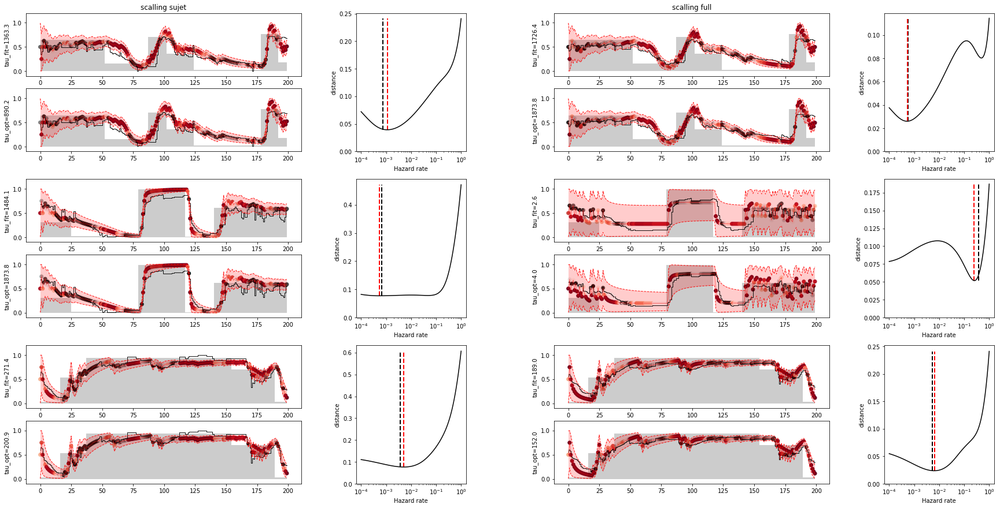

s02

scalling sujet
block 0 --> tau_fit=38.5 , h_fit=0.02597 , tau_opt=34.3 , h_opt=0.02915
block 1 --> tau_fit=5.5 , h_fit=0.18303 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=84.9 , h_fit=0.01178 , tau_opt=37.6 , h_opt=0.02656

scalling full
block 0 --> tau_fit=38.8 , h_fit=0.02578 , tau_opt=37.6 , h_opt=0.02656
block 1 --> tau_fit=6.5 , h_fit=0.15270 , tau_opt=14.8 , h_opt=0.06734
block 2 --> tau_fit=96.1 , h_fit=0.01041 , tau_opt=31.3 , h_opt=0.03199


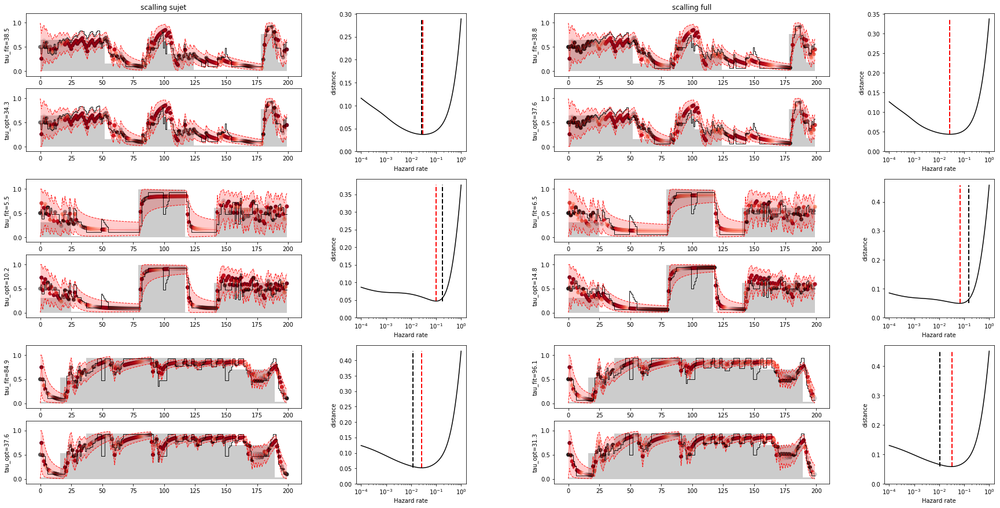

s03

scalling sujet
block 0 --> tau_fit=2.1 , h_fit=0.47048 , tau_opt=3.7 , h_opt=0.27186
block 1 --> tau_fit=5.5 , h_fit=0.18229 , tau_opt=11.2 , h_opt=0.08902
block 2 --> tau_fit=9.1 , h_fit=0.11028 , tau_opt=5.9 , h_opt=0.17074

scalling full
block 0 --> tau_fit=1.6 , h_fit=0.61874 , tau_opt=2.5 , h_opt=0.39442
block 1 --> tau_fit=4.2 , h_fit=0.23868 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=4.8 , h_fit=0.20950 , tau_opt=3.7 , h_opt=0.27186


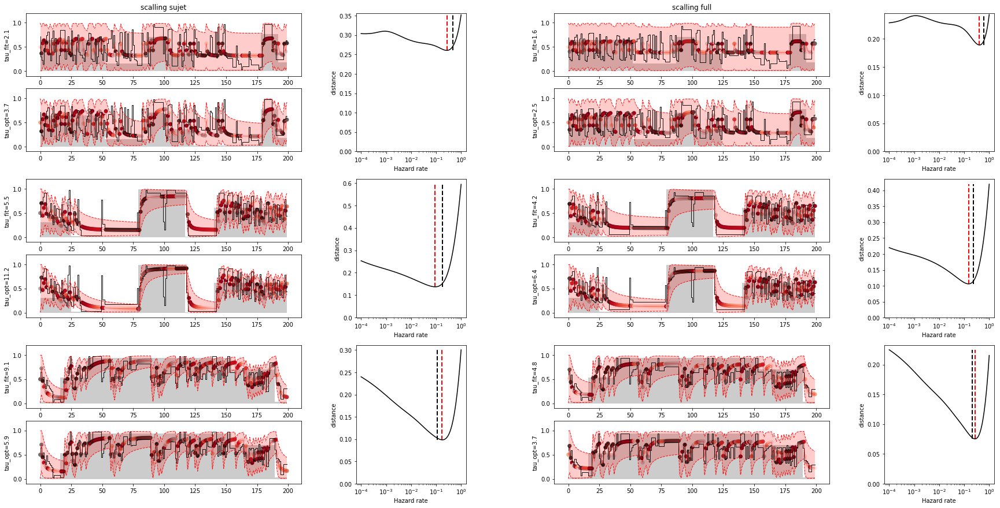

s04

scalling sujet
block 0 --> tau_fit=4.6 , h_fit=0.21927 , tau_opt=3.1 , h_opt=0.32745
block 1 --> tau_fit=7.7 , h_fit=0.12922 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=13.6 , h_fit=0.07340 , tau_opt=14.8 , h_opt=0.06734

scalling full
block 0 --> tau_fit=1.7 , h_fit=0.59519 , tau_opt=2.1 , h_opt=0.47508
block 1 --> tau_fit=2.3 , h_fit=0.43101 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=5.1 , h_fit=0.19772 , tau_opt=4.4 , h_opt=0.22570


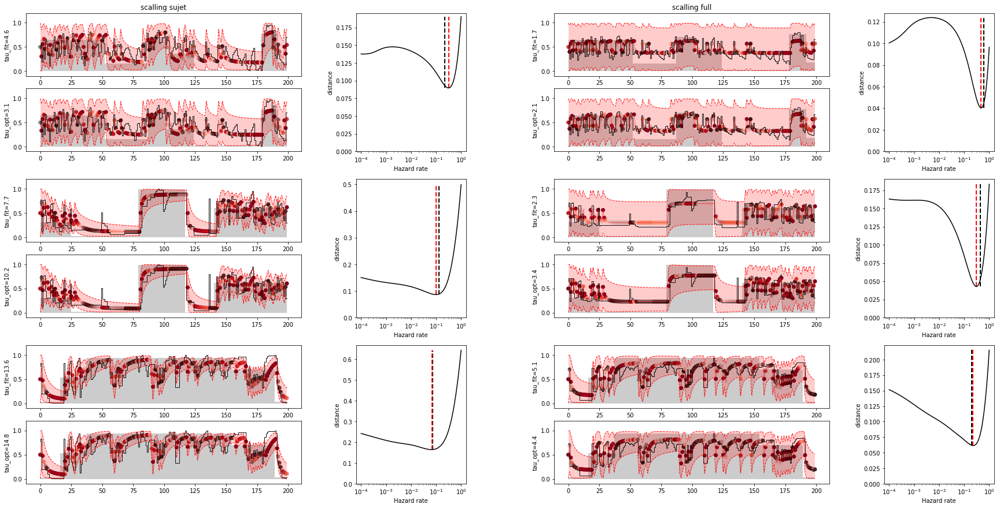

s05

scalling sujet
block 0 --> tau_fit=2.3 , h_fit=0.43574 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.2 , h_fit=0.23579 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=13.9 , h_fit=0.07203 , tau_opt=13.5 , h_opt=0.07391

scalling full
block 0 --> tau_fit=3.1 , h_fit=0.32405 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.6 , h_fit=0.18009 , tau_opt=12.3 , h_opt=0.08111
block 2 --> tau_fit=17.7 , h_fit=0.05635 , tau_opt=16.3 , h_opt=0.06136


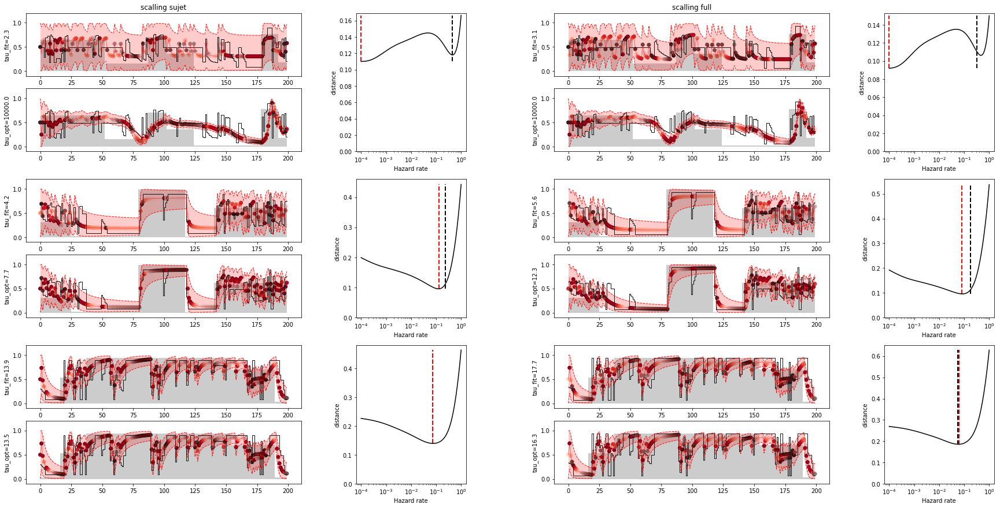

s06

scalling sujet
block 0 --> tau_fit=113.2 , h_fit=0.00883 , tau_opt=87.0 , h_opt=0.01150
block 1 --> tau_fit=12.6 , h_fit=0.07949 , tau_opt=34.3 , h_opt=0.02915
block 2 --> tau_fit=47.1 , h_fit=0.02124 , tau_opt=41.3 , h_opt=0.02420

scalling full
block 0 --> tau_fit=14756.8 , h_fit=0.00007 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.6 , h_fit=0.17856 , tau_opt=9.3 , h_opt=0.10723
block 2 --> tau_fit=39.8 , h_fit=0.02515 , tau_opt=3.1 , h_opt=0.32745


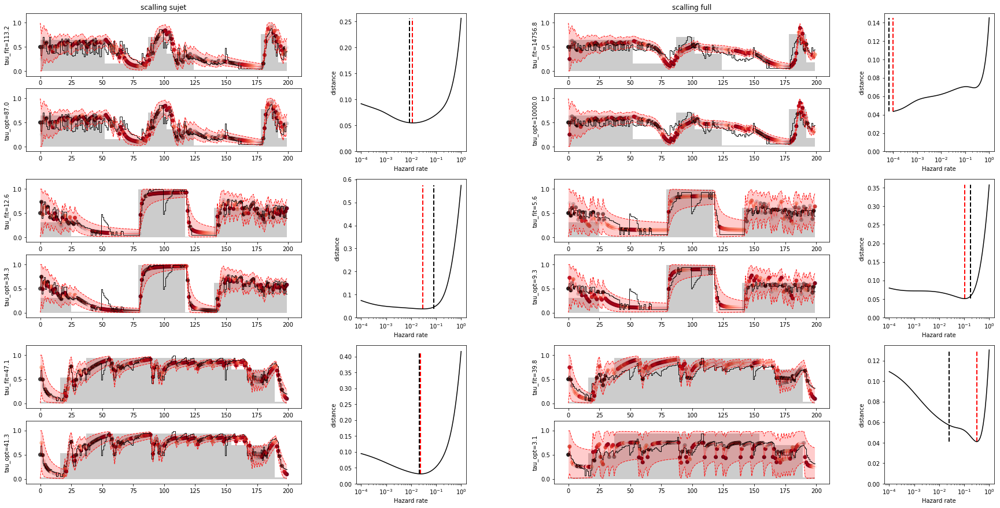

s07

scalling sujet
block 0 --> tau_fit=4.2 , h_fit=0.23711 , tau_opt=126.2 , h_opt=0.00792
block 1 --> tau_fit=9.1 , h_fit=0.11044 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=119.8 , h_fit=0.00835 , tau_opt=49.8 , h_opt=0.02009

scalling full
block 0 --> tau_fit=250.3 , h_fit=0.00399 , tau_opt=183.1 , h_opt=0.00546
block 1 --> tau_fit=3.6 , h_fit=0.27907 , tau_opt=4.4 , h_opt=0.22570
block 2 --> tau_fit=35.7 , h_fit=0.02803 , tau_opt=26.0 , h_opt=0.03854


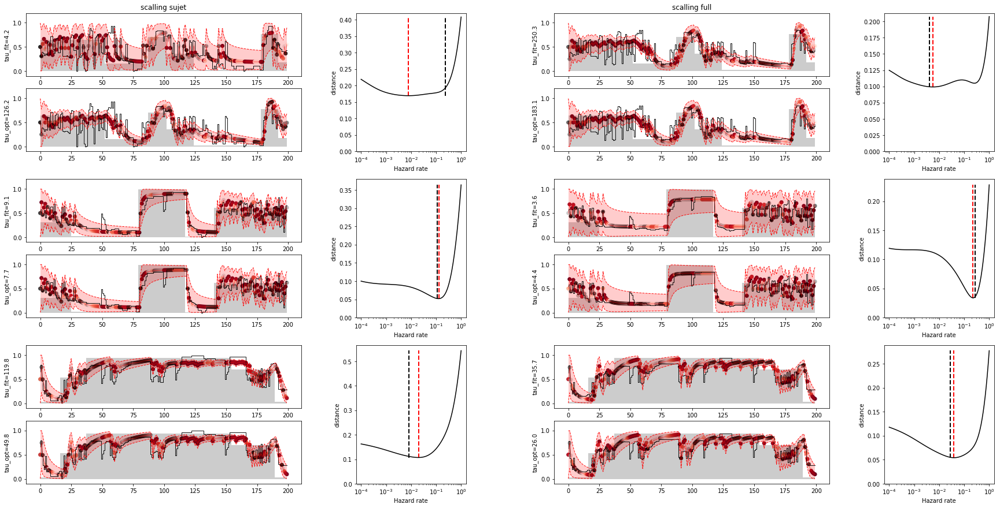

s08

scalling sujet
block 0 --> tau_fit=7022.4 , h_fit=0.00014 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=50.1 , h_fit=0.01995 , tau_opt=9.3 , h_opt=0.10723
block 2 --> tau_fit=8.8 , h_fit=0.11374 , tau_opt=8.5 , h_opt=0.11768

scalling full
block 0 --> tau_fit=5988.2 , h_fit=0.00017 , tau_opt=6892.6 , h_opt=0.00015
block 1 --> tau_fit=103.2 , h_fit=0.00969 , tau_opt=37.6 , h_opt=0.02656
block 2 --> tau_fit=12.1 , h_fit=0.08276 , tau_opt=12.3 , h_opt=0.08111


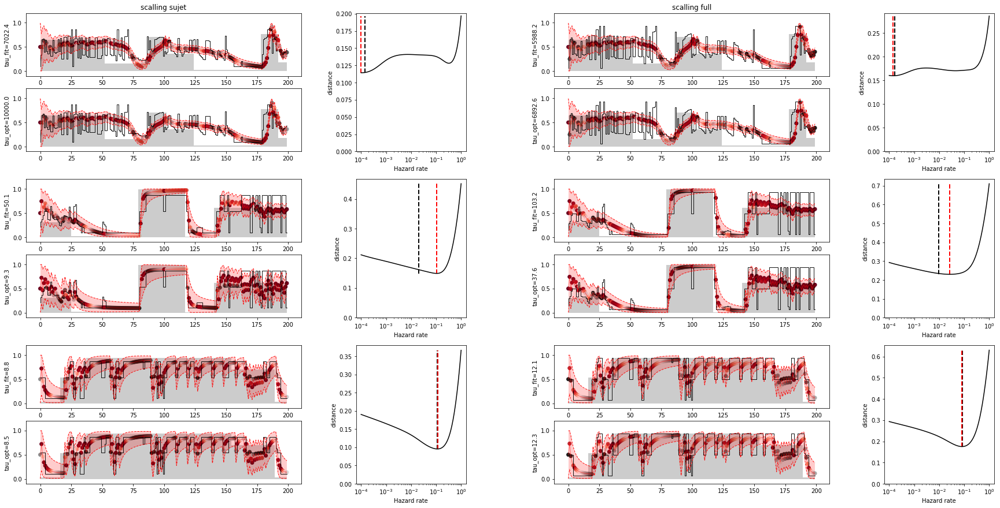

s09

scalling sujet
block 0 --> tau_fit=2.3 , h_fit=0.42929 , tau_opt=3.1 , h_opt=0.32745
block 1 --> tau_fit=2.6 , h_fit=0.38137 , tau_opt=3.1 , h_opt=0.32745
block 2 --> tau_fit=78.0 , h_fit=0.01283 , tau_opt=291.5 , h_opt=0.00343

scalling full
block 0 --> tau_fit=33612.7 , h_fit=0.00003 , tau_opt=2.3 , h_opt=0.43288
block 1 --> tau_fit=2.2 , h_fit=0.46294 , tau_opt=4.4 , h_opt=0.22570
block 2 --> tau_fit=1.7 , h_fit=0.58932 , tau_opt=183.1 , h_opt=0.00546


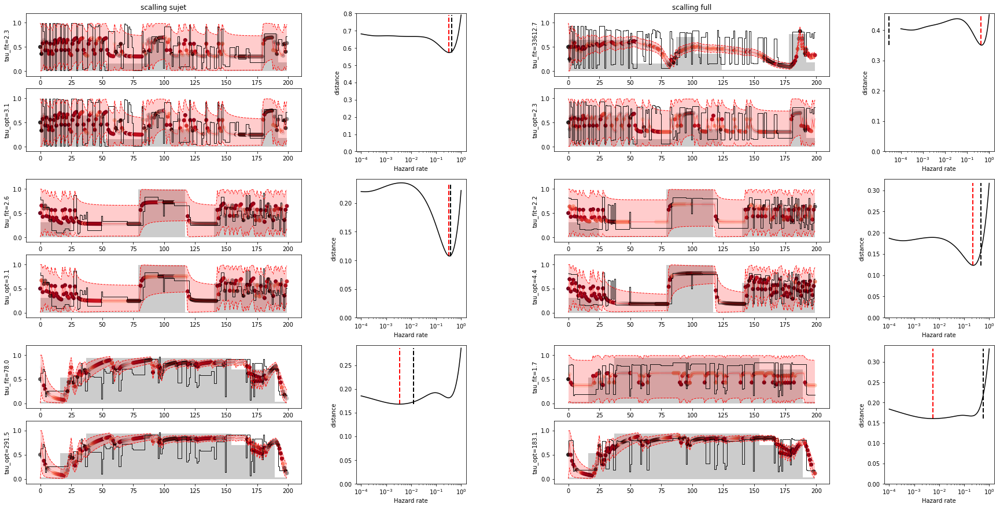

s10

scalling sujet
block 0 --> tau_fit=572.8 , h_fit=0.00175 , tau_opt=104.8 , h_opt=0.00955
block 1 --> tau_fit=3.8 , h_fit=0.26265 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=562.3 , h_fit=0.00178 , tau_opt=559.1 , h_opt=0.00179

scalling full
block 0 --> tau_fit=680.4 , h_fit=0.00147 , tau_opt=115.0 , h_opt=0.00870
block 1 --> tau_fit=3.7 , h_fit=0.27105 , tau_opt=5.3 , h_opt=0.18738
block 2 --> tau_fit=577.0 , h_fit=0.00173 , tau_opt=385.4 , h_opt=0.00260


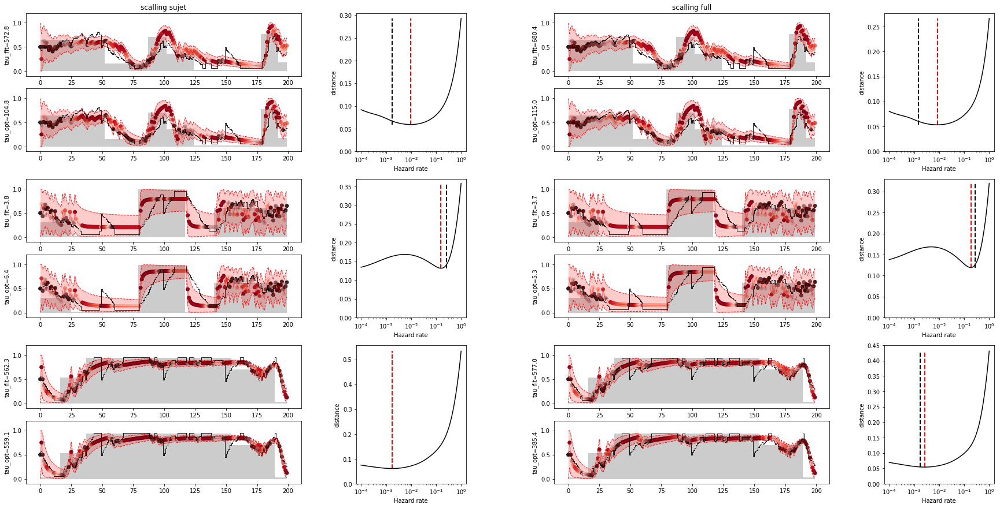

s11

scalling sujet
block 0 --> tau_fit=3.7 , h_fit=0.26678 , tau_opt=9111.6 , h_opt=0.00011
block 1 --> tau_fit=8.7 , h_fit=0.11520 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=31.6 , h_fit=0.03169 , tau_opt=34.3 , h_opt=0.02915

scalling full
block 0 --> tau_fit=18.0 , h_fit=0.05556 , tau_opt=34.3 , h_opt=0.02915
block 1 --> tau_fit=20.2 , h_fit=0.04949 , tau_opt=21.5 , h_opt=0.04642
block 2 --> tau_fit=44.2 , h_fit=0.02260 , tau_opt=41.3 , h_opt=0.02420


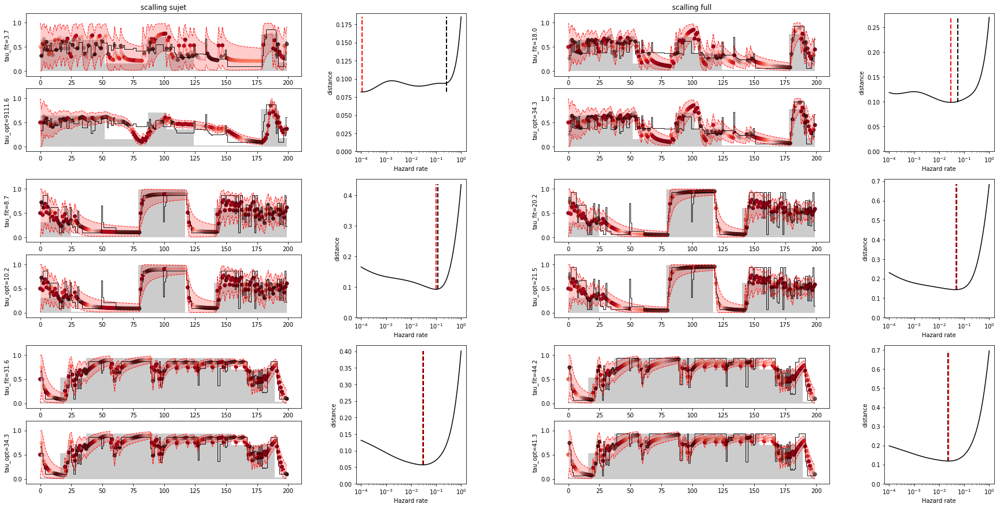

s12

scalling sujet
block 0 --> tau_fit=14768.8 , h_fit=0.00007 , tau_opt=1.9 , h_opt=0.52140
block 1 --> tau_fit=1.5 , h_fit=0.67912 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=4.9 , h_fit=0.20222 , tau_opt=4.4 , h_opt=0.22570

scalling full
block 0 --> tau_fit=178.6 , h_fit=0.00560 , tau_opt=95.5 , h_opt=0.01048
block 1 --> tau_fit=29.9 , h_fit=0.03347 , tau_opt=17.9 , h_opt=0.05591
block 2 --> tau_fit=14.0 , h_fit=0.07167 , tau_opt=23.6 , h_opt=0.04229


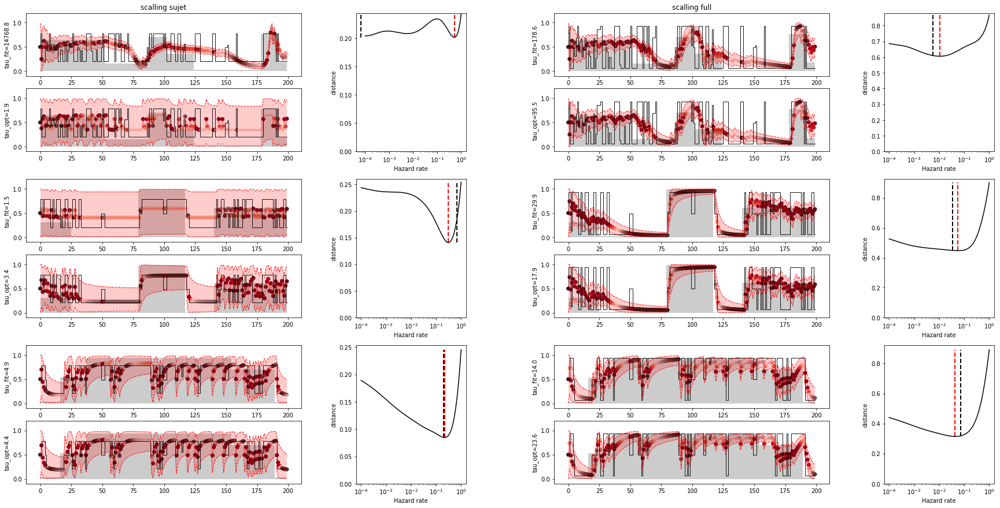

In [14]:
evaluating (new_bet_sujet, new_bet_full, h_bet_sujet, h_bet_full)

s01

scalling sujet
block 0
pause 0 --> tau_fit=1478.7 , h_fit=0.00068 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=2319.9 , h_fit=0.00043 , tau_opt=2983.6 , h_opt=0.00034
pause 2 --> tau_fit=45641964.8 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=12445.7 , h_fit=0.00008 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=212.5 , h_fit=0.00471 , tau_opt=265.6 , h_opt=0.00376
pause 1 --> tau_fit=31313.3 , h_fit=0.00003 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=7762.9 , h_fit=0.00013 , tau_opt=6892.6 , h_opt=0.00015
pause 3 --> tau_fit=12.8 , h_fit=0.07797 , tau_opt=1.2 , h_opt=0.83022
block 2
pause 0 --> tau_fit=714.0 , h_fit=0.00140 , tau_opt=559.1 , h_opt=0.00179
pause 1 --> tau_fit=118.2 , h_fit=0.00846 , tau_opt=200.9 , h_opt=0.00498
pause 2 --> tau_fit=647368299.7 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=107.7 , h_fit=0.00928 , tau_opt=104.8 , h_opt=0.00955

scalling full
block 0
pause 0 --> tau_fit=34

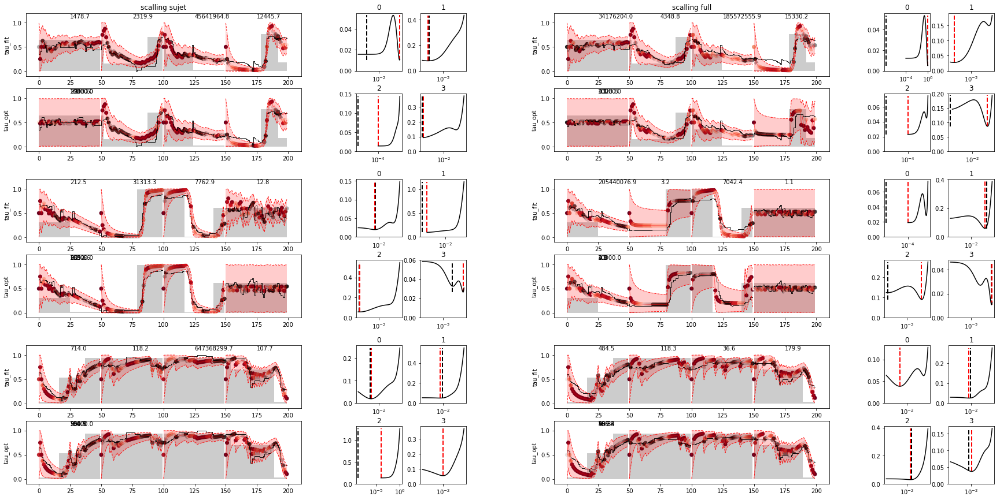

s02

scalling sujet
block 0
pause 0 --> tau_fit=44.8 , h_fit=0.02233 , tau_opt=34.3 , h_opt=0.02915
pause 1 --> tau_fit=44.5 , h_fit=0.02245 , tau_opt=41.3 , h_opt=0.02420
pause 2 --> tau_fit=16.2 , h_fit=0.06167 , tau_opt=17.9 , h_opt=0.05591
pause 3 --> tau_fit=76.7 , h_fit=0.01304 , tau_opt=12.3 , h_opt=0.08111
block 1
pause 0 --> tau_fit=6.4 , h_fit=0.15511 , tau_opt=34.3 , h_opt=0.02915
pause 1 --> tau_fit=302.2 , h_fit=0.00331 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=31.5 , h_fit=0.03176 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=1.1 , h_fit=0.93374 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=33.6 , h_fit=0.02976 , tau_opt=28.5 , h_opt=0.03511
pause 1 --> tau_fit=116.7 , h_fit=0.00857 , tau_opt=65.8 , h_opt=0.01520
pause 2 --> tau_fit=20.6 , h_fit=0.04848 , tau_opt=28.5 , h_opt=0.03511
pause 3 --> tau_fit=22.0 , h_fit=0.04545 , tau_opt=26.0 , h_opt=0.03854

scalling full
block 0
pause 0 --> tau_fit=67.3 , h_fit=0.01487 , tau_opt=49.8 , h_opt=0.0200

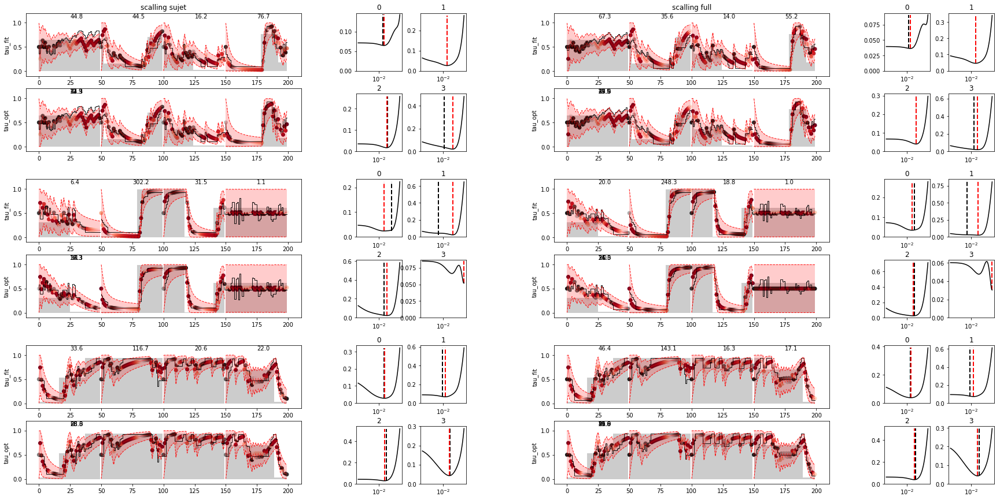

s03

scalling sujet
block 0
pause 0 --> tau_fit=23866810.9 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=1.7 , h_fit=0.57144 , tau_opt=2.3 , h_opt=0.43288
pause 2 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.3 , h_opt=0.75646
pause 3 --> tau_fit=8.8 , h_fit=0.11421 , tau_opt=8.5 , h_opt=0.11768
block 1
pause 0 --> tau_fit=5.4 , h_fit=0.18632 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=5.7 , h_fit=0.17595 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=10.1 , h_fit=0.09949 , tau_opt=19.6 , h_opt=0.05094
pause 3 --> tau_fit=22.7 , h_fit=0.04407 , tau_opt=14.8 , h_opt=0.06734
block 2
pause 0 --> tau_fit=10.6 , h_fit=0.09430 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=6.1 , h_fit=0.16484 , tau_opt=4.4 , h_opt=0.22570
pause 2 --> tau_fit=9.0 , h_fit=0.11149 , tau_opt=3.4 , h_opt=0.29836
pause 3 --> tau_fit=10.3 , h_fit=0.09685 , tau_opt=3.7 , h_opt=0.27186

scalling full
block 0
pause 0 --> tau_fit=34245419.0 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
p

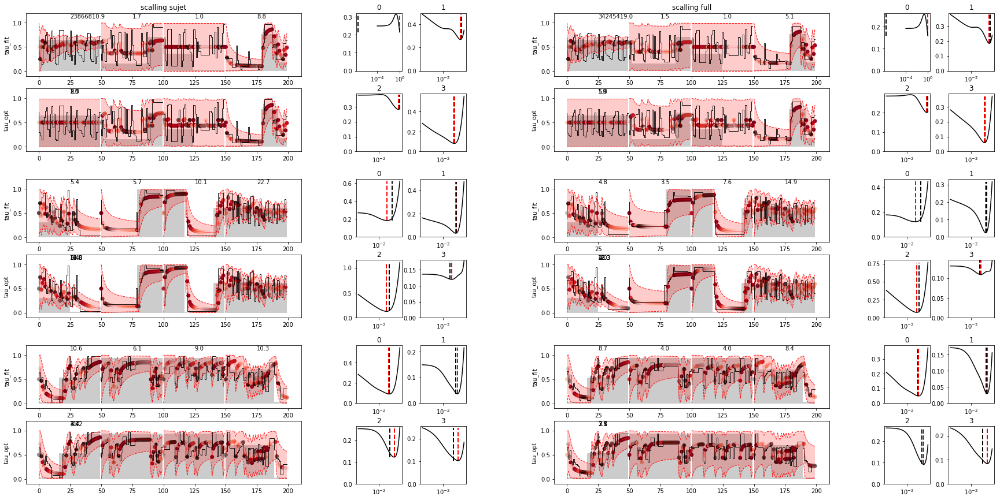

s04

scalling sujet
block 0
pause 0 --> tau_fit=1954.1 , h_fit=0.00051 , tau_opt=1.5 , h_opt=0.68926
pause 1 --> tau_fit=2.0 , h_fit=0.50999 , tau_opt=1.9 , h_opt=0.52140
pause 2 --> tau_fit=23925944.3 , h_fit=0.00000 , tau_opt=1.9 , h_opt=0.52140
pause 3 --> tau_fit=6.9 , h_fit=0.14526 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=12.4 , h_fit=0.08080 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=1735.3 , h_fit=0.00058 , tau_opt=977.0 , h_opt=0.00102
pause 2 --> tau_fit=4.9 , h_fit=0.20496 , tau_opt=11.2 , h_opt=0.08902
pause 3 --> tau_fit=10.0 , h_fit=0.10039 , tau_opt=5.3 , h_opt=0.18738
block 2
pause 0 --> tau_fit=13.7 , h_fit=0.07322 , tau_opt=26.0 , h_opt=0.03854
pause 1 --> tau_fit=31.9 , h_fit=0.03133 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=21.6 , h_fit=0.04622 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=12.2 , h_fit=0.08177 , tau_opt=17.9 , h_opt=0.05591

scalling full
block 0
pause 0 --> tau_fit=14225022.0 , h_fit=0.00000 , tau_opt=1.5 , h_opt

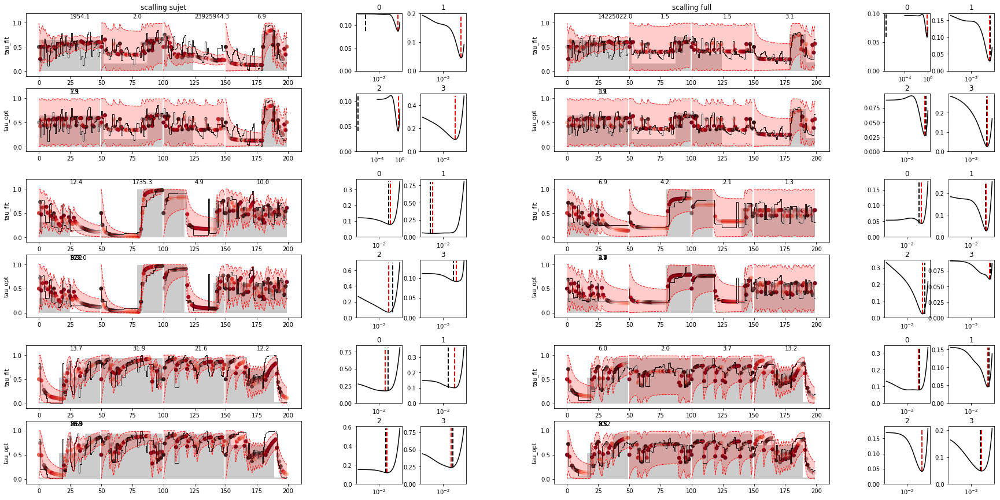

s05

scalling sujet
block 0
pause 0 --> tau_fit=25366394.2 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=276.7 , h_fit=0.00361 , tau_opt=1.6 , h_opt=0.62803
pause 2 --> tau_fit=2.1 , h_fit=0.48370 , tau_opt=1.9 , h_opt=0.52140
pause 3 --> tau_fit=3.7 , h_fit=0.26668 , tau_opt=5.9 , h_opt=0.17074
block 1
pause 0 --> tau_fit=273.1 , h_fit=0.00366 , tau_opt=104.8 , h_opt=0.00955
pause 1 --> tau_fit=14.2 , h_fit=0.07027 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=4.9 , h_fit=0.20214 , tau_opt=9.3 , h_opt=0.10723
pause 3 --> tau_fit=1.7 , h_fit=0.59227 , tau_opt=1.7 , h_opt=0.57224
block 2
pause 0 --> tau_fit=3.3 , h_fit=0.30588 , tau_opt=6.4 , h_opt=0.15557
pause 1 --> tau_fit=4.2 , h_fit=0.23989 , tau_opt=7.1 , h_opt=0.14175
pause 2 --> tau_fit=12.2 , h_fit=0.08209 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=79.1 , h_fit=0.01264 , tau_opt=166.8 , h_opt=0.00599

scalling full
block 0
pause 0 --> tau_fit=36438165.6 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00

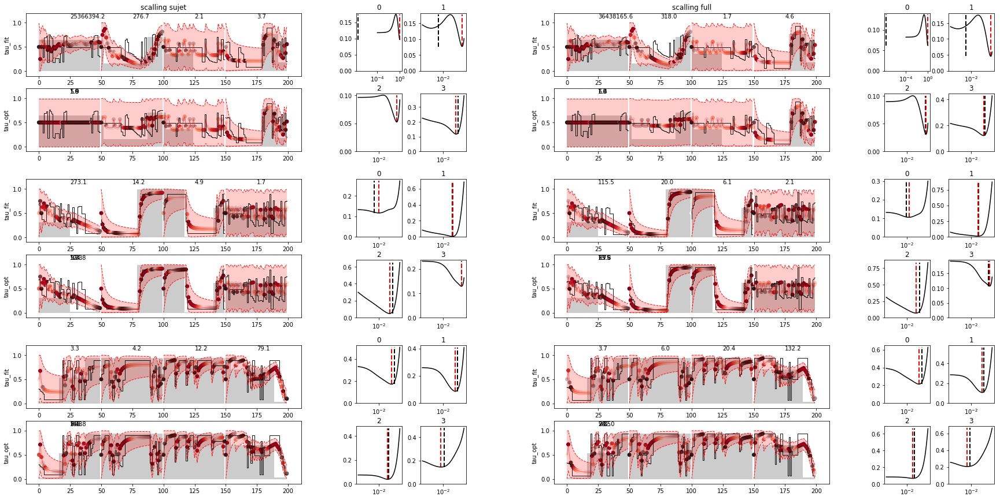

s06

scalling sujet
block 0
pause 0 --> tau_fit=23720521.6 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=175.2 , h_fit=0.00571 , tau_opt=2.5 , h_opt=0.39442
pause 2 --> tau_fit=45.0 , h_fit=0.02220 , tau_opt=34.3 , h_opt=0.02915
pause 3 --> tau_fit=167.7 , h_fit=0.00596 , tau_opt=17.9 , h_opt=0.05591
block 1
pause 0 --> tau_fit=44.0 , h_fit=0.02272 , tau_opt=41.3 , h_opt=0.02420
pause 1 --> tau_fit=44.1 , h_fit=0.02269 , tau_opt=65.8 , h_opt=0.01520
pause 2 --> tau_fit=46.5 , h_fit=0.02150 , tau_opt=45.3 , h_opt=0.02205
pause 3 --> tau_fit=42.6 , h_fit=0.02347 , tau_opt=34.3 , h_opt=0.02915
block 2
pause 0 --> tau_fit=17.6 , h_fit=0.05695 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=36.9 , h_fit=0.02711 , tau_opt=34.3 , h_opt=0.02915
pause 2 --> tau_fit=470.0 , h_fit=0.00213 , tau_opt=242.0 , h_opt=0.00413
pause 3 --> tau_fit=67.7 , h_fit=0.01476 , tau_opt=59.9 , h_opt=0.01668

scalling full
block 0
pause 0 --> tau_fit=89548558.6 , h_fit=0.00000 , tau_opt=1.0 

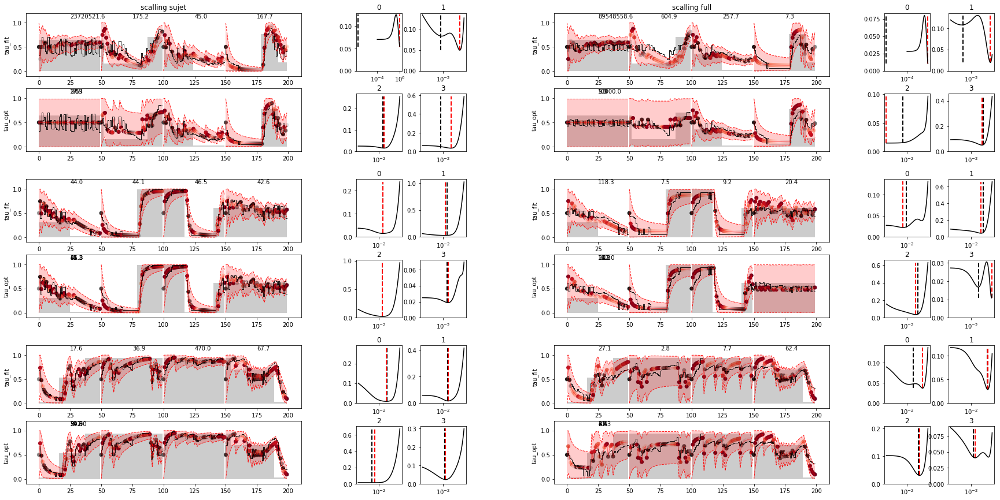

s07

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.37469 , tau_opt=2.1 , h_opt=0.47508
pause 1 --> tau_fit=348.4 , h_fit=0.00287 , tau_opt=87.0 , h_opt=0.01150
pause 2 --> tau_fit=39.4 , h_fit=0.02537 , tau_opt=37.6 , h_opt=0.02656
pause 3 --> tau_fit=164.3 , h_fit=0.00609 , tau_opt=79.2 , h_opt=0.01262
block 1
pause 0 --> tau_fit=6.7 , h_fit=0.14899 , tau_opt=4.4 , h_opt=0.22570
pause 1 --> tau_fit=10.0 , h_fit=0.10003 , tau_opt=7.7 , h_opt=0.12915
pause 2 --> tau_fit=16.3 , h_fit=0.06153 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=18.3 , h_fit=0.05455 , tau_opt=1.3 , h_opt=0.75646
block 2
pause 0 --> tau_fit=25.9 , h_fit=0.03862 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=5.2 , h_fit=0.19103 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=120442214.9 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=88.6 , h_fit=0.01128 , tau_opt=59.9 , h_opt=0.01668

scalling full
block 0
pause 0 --> tau_fit=19.4 , h_fit=0.05151 , tau_opt=1.3 , h_opt=0.

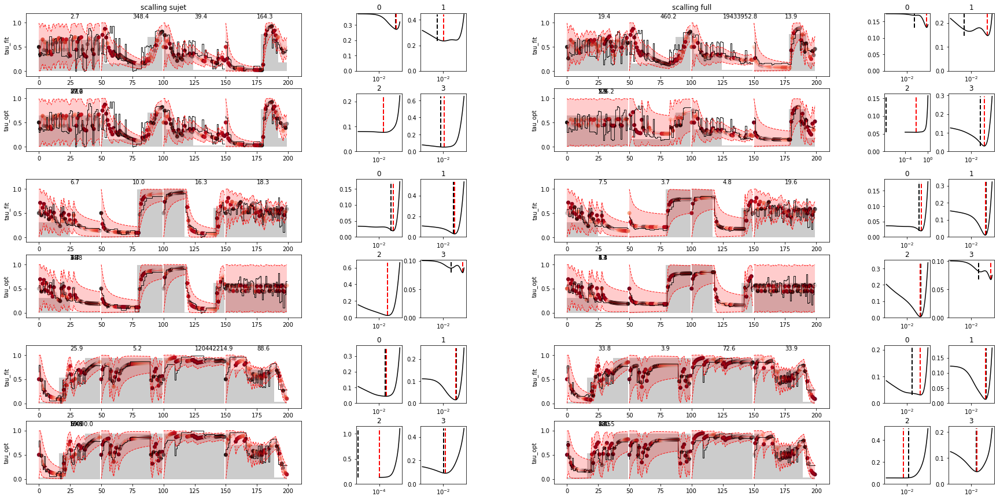

s08

scalling sujet
block 0
pause 0 --> tau_fit=21525686.5 , h_fit=0.00000 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=1008.8 , h_fit=0.00099 , tau_opt=1.7 , h_opt=0.57224
pause 2 --> tau_fit=1.3 , h_fit=0.74410 , tau_opt=1.6 , h_opt=0.62803
pause 3 --> tau_fit=6.7 , h_fit=0.14839 , tau_opt=8.5 , h_opt=0.11768
block 1
pause 0 --> tau_fit=4.8 , h_fit=0.20693 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=5.6 , h_fit=0.17956 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=6.6 , h_fit=0.15117 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=14448166.7 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=20.8 , h_fit=0.04808 , tau_opt=12.3 , h_opt=0.08111
pause 1 --> tau_fit=4.9 , h_fit=0.20486 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=5.7 , h_fit=0.17530 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=32.5 , h_fit=0.03077 , tau_opt=23.6 , h_opt=0.04229

scalling full
block 0
pause 0 --> tau_fit=14949115.1 , h_fit=0.00000 , tau_opt=1.1 , h_opt

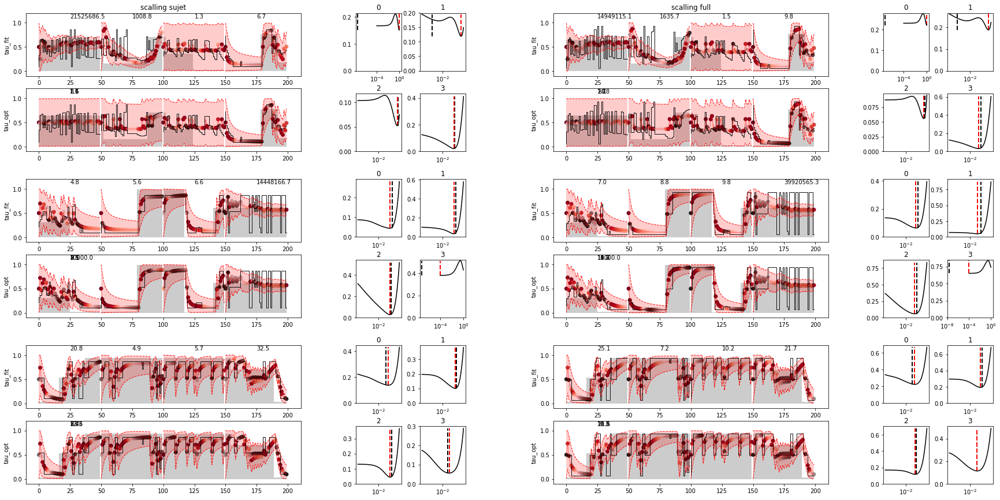

s09

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.37238 , tau_opt=3.1 , h_opt=0.32745
pause 1 --> tau_fit=1.6 , h_fit=0.60786 , tau_opt=1.7 , h_opt=0.57224
pause 2 --> tau_fit=5.9 , h_fit=0.17005 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=2.3 , h_fit=0.44251 , tau_opt=2.8 , h_opt=0.35938
block 1
pause 0 --> tau_fit=7.1 , h_fit=0.14115 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=2.1 , h_fit=0.46650 , tau_opt=2.8 , h_opt=0.35938
pause 2 --> tau_fit=3.1 , h_fit=0.32398 , tau_opt=2.8 , h_opt=0.35938
pause 3 --> tau_fit=353.9 , h_fit=0.00283 , tau_opt=1.5 , h_opt=0.68926
block 2
pause 0 --> tau_fit=642.4 , h_fit=0.00156 , tau_opt=1.7 , h_opt=0.57224
pause 1 --> tau_fit=199.9 , h_fit=0.00500 , tau_opt=265.6 , h_opt=0.00376
pause 2 --> tau_fit=3.3 , h_fit=0.29894 , tau_opt=3.7 , h_opt=0.27186
pause 3 --> tau_fit=51.8 , h_fit=0.01932 , tau_opt=115.0 , h_opt=0.00870

scalling full
block 0
pause 0 --> tau_fit=2.4 , h_fit=0.41111 , tau_opt=3.1 , h_opt=0.32745
pause 1 -->

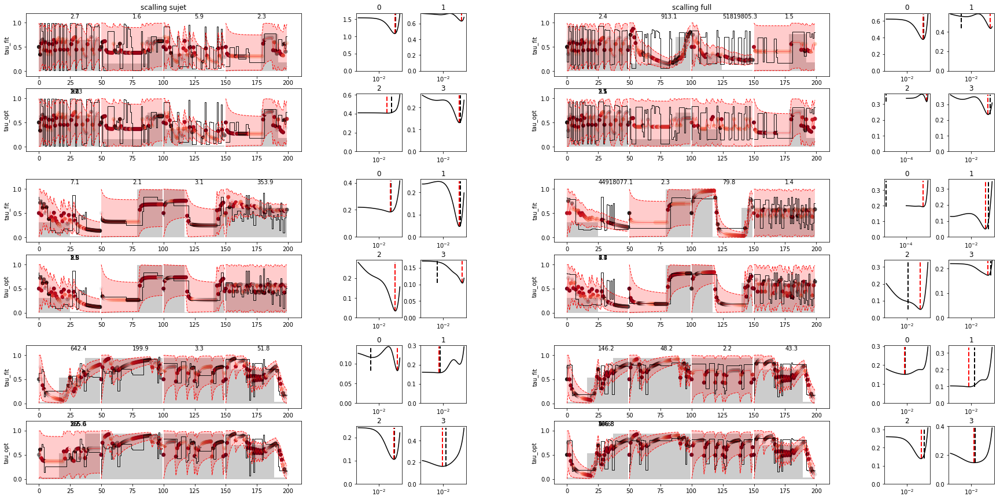

s10

scalling sujet
block 0
pause 0 --> tau_fit=43.6 , h_fit=0.02295 , tau_opt=41.3 , h_opt=0.02420
pause 1 --> tau_fit=4907.0 , h_fit=0.00020 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=21.1 , h_fit=0.04732 , tau_opt=31.3 , h_opt=0.03199
pause 3 --> tau_fit=5.5 , h_fit=0.18322 , tau_opt=10.2 , h_opt=0.09770
block 1
pause 0 --> tau_fit=12.5 , h_fit=0.07985 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=3.7 , h_fit=0.26980 , tau_opt=5.9 , h_opt=0.17074
pause 2 --> tau_fit=3.2 , h_fit=0.31291 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=40.0 , h_fit=0.02498 , tau_opt=49.8 , h_opt=0.02009
block 2
pause 0 --> tau_fit=789.1 , h_fit=0.00127 , tau_opt=1417.5 , h_opt=0.00071
pause 1 --> tau_fit=171.1 , h_fit=0.00585 , tau_opt=385.4 , h_opt=0.00260
pause 2 --> tau_fit=22915291.8 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=240.0 , h_fit=0.00417 , tau_opt=422.9 , h_opt=0.00236

scalling full
block 0
pause 0 --> tau_fit=65.8 , h_fit=0.01519 , tau_op

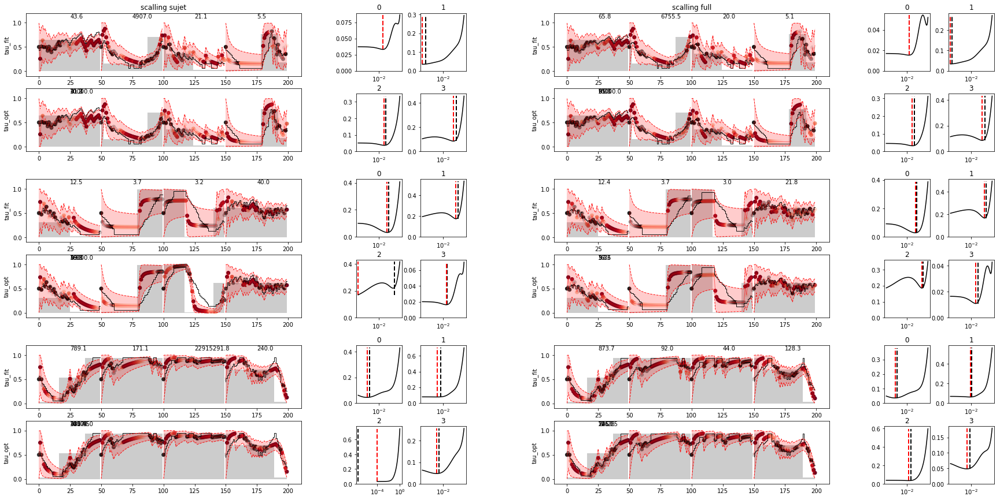

s11

scalling sujet
block 0
pause 0 --> tau_fit=49636396.8 , h_fit=0.00000 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=8277.7 , h_fit=0.00012 , tau_opt=1.1 , h_opt=0.91116
pause 2 --> tau_fit=14.2 , h_fit=0.07018 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=13.6 , h_fit=0.07329 , tau_opt=13.5 , h_opt=0.07391
block 1
pause 0 --> tau_fit=24.0 , h_fit=0.04174 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=7.2 , h_fit=0.13820 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=27.1 , h_fit=0.03695 , tau_opt=13.5 , h_opt=0.07391
pause 3 --> tau_fit=16.2 , h_fit=0.06173 , tau_opt=28.5 , h_opt=0.03511
block 2
pause 0 --> tau_fit=191.5 , h_fit=0.00522 , tau_opt=200.9 , h_opt=0.00498
pause 1 --> tau_fit=36.1 , h_fit=0.02768 , tau_opt=19.6 , h_opt=0.05094
pause 2 --> tau_fit=21.2 , h_fit=0.04712 , tau_opt=54.6 , h_opt=0.01831
pause 3 --> tau_fit=24.0 , h_fit=0.04164 , tau_opt=21.5 , h_opt=0.04642

scalling full
block 0
pause 0 --> tau_fit=40569902.6 , h_fit=0.00000 , tau_opt=1.2

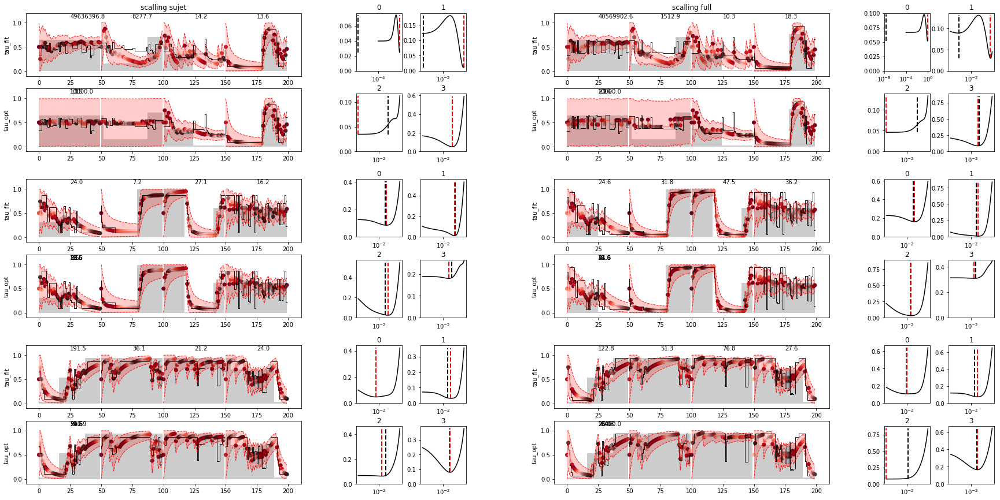

s12

scalling sujet
block 0
pause 0 --> tau_fit=30531240.0 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=148.8 , h_fit=0.00672 , tau_opt=1.9 , h_opt=0.52140
pause 2 --> tau_fit=47299660.4 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=2.1 , h_fit=0.48481 , tau_opt=4.0 , h_opt=0.24771
block 1
pause 0 --> tau_fit=68918428.7 , h_fit=0.00000 , tau_opt=3274.5 , h_opt=0.00031
pause 1 --> tau_fit=3.0 , h_fit=0.33712 , tau_opt=3.7 , h_opt=0.27186
pause 2 --> tau_fit=3.0 , h_fit=0.32945 , tau_opt=3.7 , h_opt=0.27186
pause 3 --> tau_fit=1.1 , h_fit=0.94945 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=1.9 , h_fit=0.51363 , tau_opt=3.7 , h_opt=0.27186
pause 1 --> tau_fit=2.7 , h_fit=0.36817 , tau_opt=3.7 , h_opt=0.27186
pause 2 --> tau_fit=5.8 , h_fit=0.17375 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=22.7 , h_fit=0.04415 , tau_opt=12.3 , h_opt=0.08111

scalling full
block 0
pause 0 --> tau_fit=21265233.6 , h_fit=0.00000 , tau_opt=1.0 

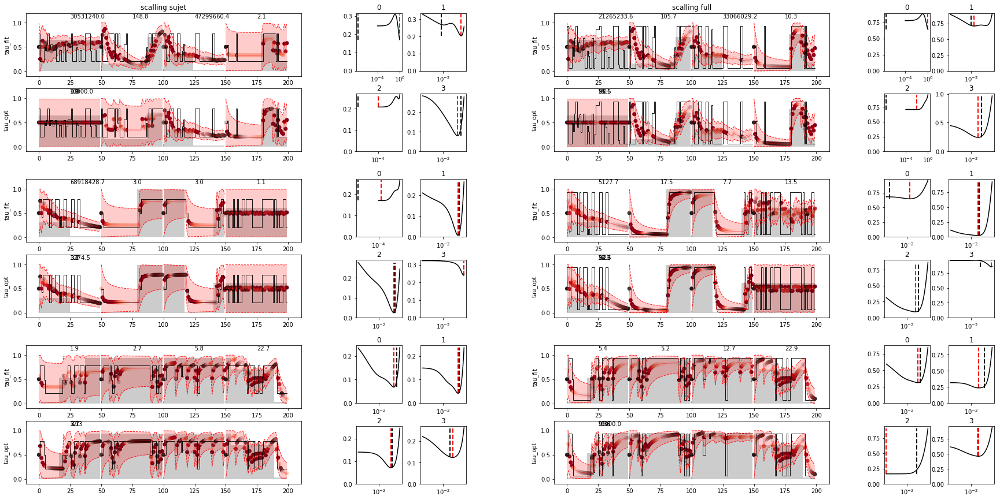

In [15]:
evaluating (new_bet_sujet, new_bet_full, h_bet_sujet, h_bet_full, show='h_pause')

### VA

s01

scalling sujet
block 0

/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:17: RuntimeWarning: All-NaN slice encountered
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: RuntimeWarning: All-NaN slice encountered


 --> tau_fit=6.0 , h_fit=0.16574 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=7.9 , h_fit=0.12660 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=1405.2 , h_fit=0.00071 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=1.4 , h_fit=0.70526 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=3.2 , h_fit=0.30922 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=416.7 , h_fit=0.00240 , tau_opt=10000.0 , h_opt=0.00010


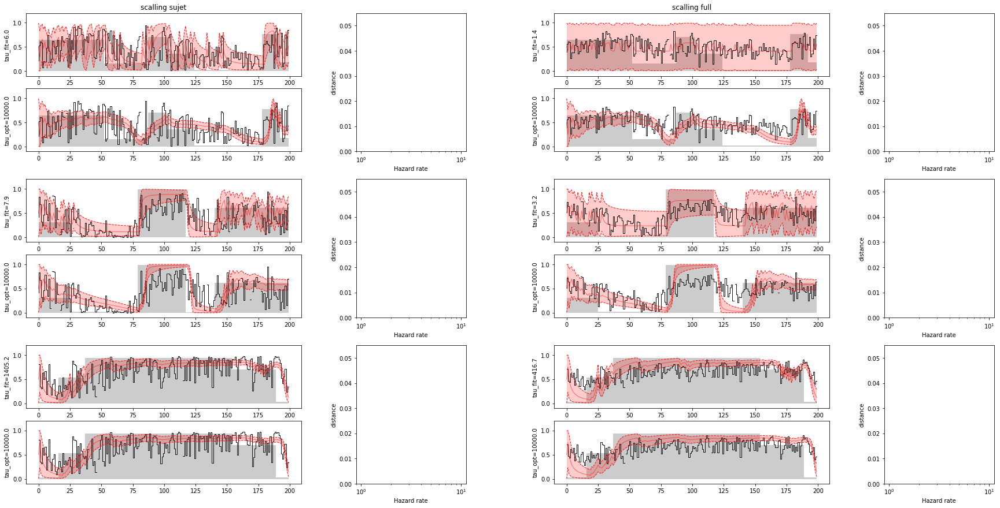

s02

scalling sujet
block 0 --> tau_fit=3.0 , h_fit=0.33079 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=11.1 , h_fit=0.09012 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=15.5 , h_fit=0.06437 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=2.3 , h_fit=0.43554 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.6 , h_fit=0.11616 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=14.2 , h_fit=0.07043 , tau_opt=10000.0 , h_opt=0.00010


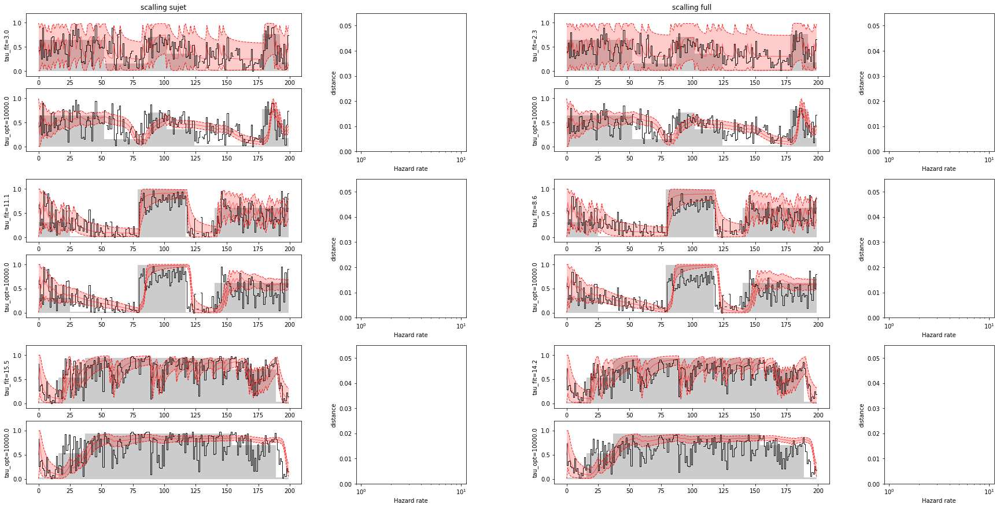

s03

scalling sujet
block 0 --> tau_fit=8.7 , h_fit=0.11549 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=9.6 , h_fit=0.10409 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=70.7 , h_fit=0.01415 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=3.7 , h_fit=0.26909 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.6 , h_fit=0.21765 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=44.2 , h_fit=0.02261 , tau_opt=10000.0 , h_opt=0.00010


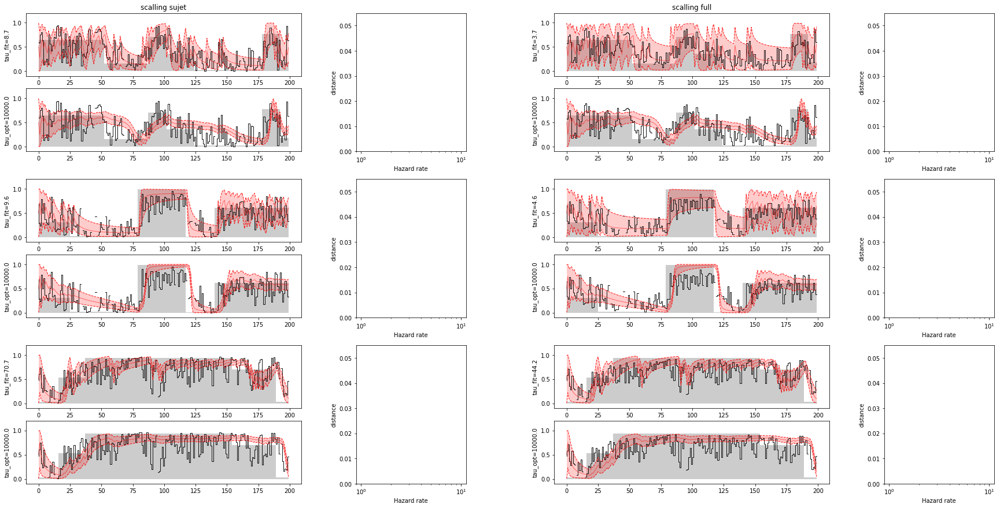

s04

scalling sujet
block 0 --> tau_fit=9.2 , h_fit=0.10917 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=7.0 , h_fit=0.14328 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=7.2 , h_fit=0.13925 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=6.2 , h_fit=0.16172 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.3 , h_fit=0.18928 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=7.8 , h_fit=0.12898 , tau_opt=10000.0 , h_opt=0.00010


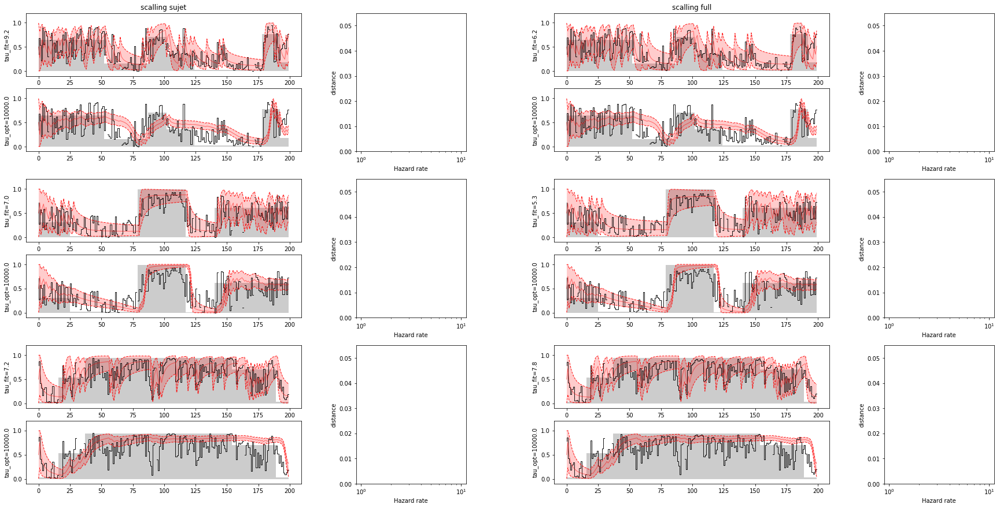

s05

scalling sujet
block 0 --> tau_fit=18.4 , h_fit=0.05446 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.3 , h_fit=0.23154 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=46.3 , h_fit=0.02161 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=9.1 , h_fit=0.10942 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=3.7 , h_fit=0.27389 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=547.0 , h_fit=0.00183 , tau_opt=10000.0 , h_opt=0.00010


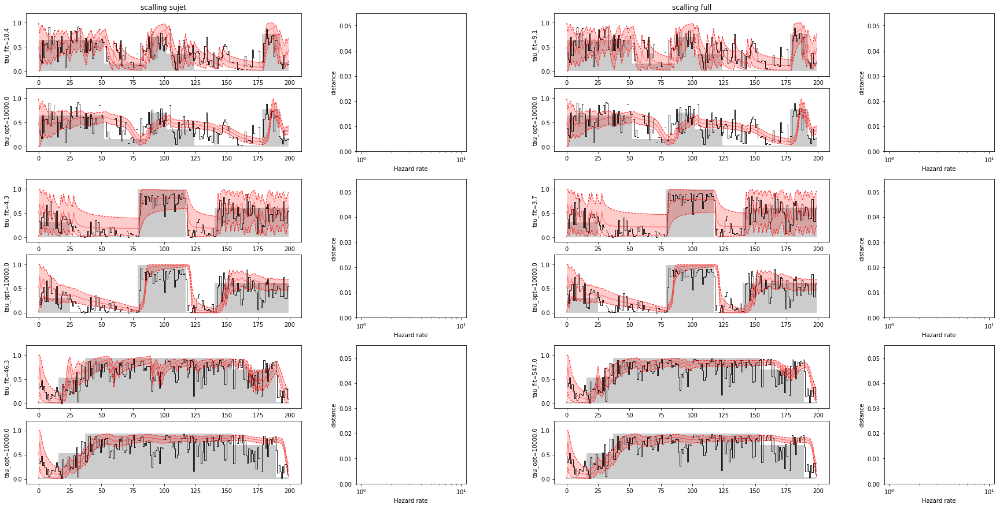

s06

scalling sujet
block 0 --> tau_fit=7.2 , h_fit=0.13915 , tau_opt=7.1 , h_opt=0.14175
block 1 --> tau_fit=7.5 , h_fit=0.13386 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=19.9 , h_fit=0.05034 , tau_opt=31.3 , h_opt=0.03199

scalling full
block 0 --> tau_fit=5.0 , h_fit=0.20156 , tau_opt=4.0 , h_opt=0.24771
block 1 --> tau_fit=6.2 , h_fit=0.16046 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=182.9 , h_fit=0.00547 , tau_opt=4.9 , h_opt=0.20565


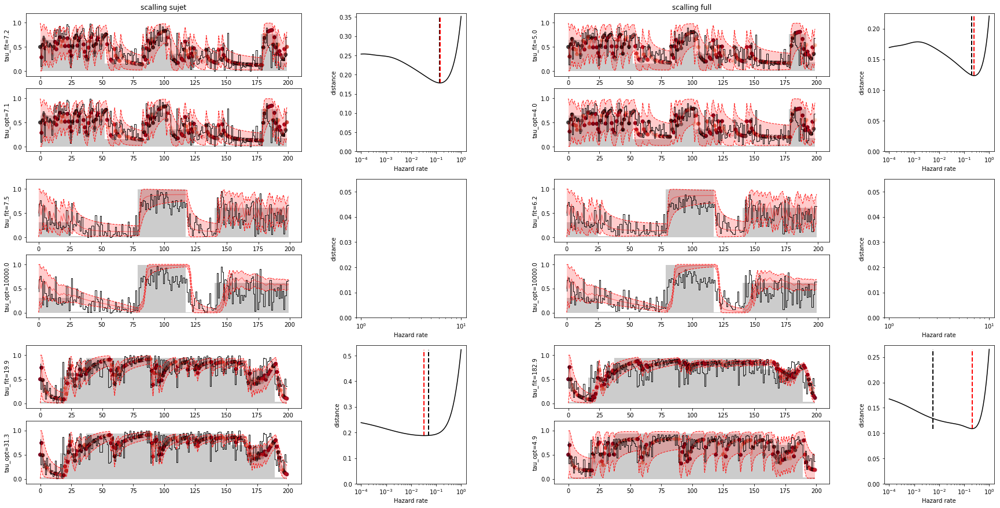

s07

scalling sujet
block 0 --> tau_fit=21.4 , h_fit=0.04676 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=6.1 , h_fit=0.16264 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=21.3 , h_fit=0.04689 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=25.0 , h_fit=0.04004 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.5 , h_fit=0.11826 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=20.1 , h_fit=0.04971 , tau_opt=10000.0 , h_opt=0.00010


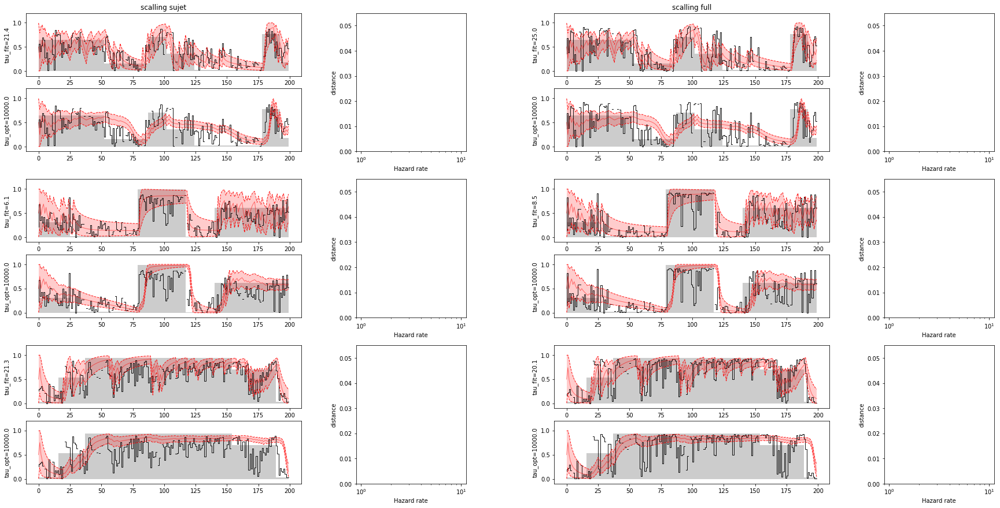

s08

scalling sujet
block 0 --> tau_fit=4.4 , h_fit=0.22584 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=2.4 , h_fit=0.42361 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=3.5 , h_fit=0.28297 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=3.4 , h_fit=0.29190 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=2.2 , h_fit=0.46275 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=1.7 , h_fit=0.59727 , tau_opt=10000.0 , h_opt=0.00010


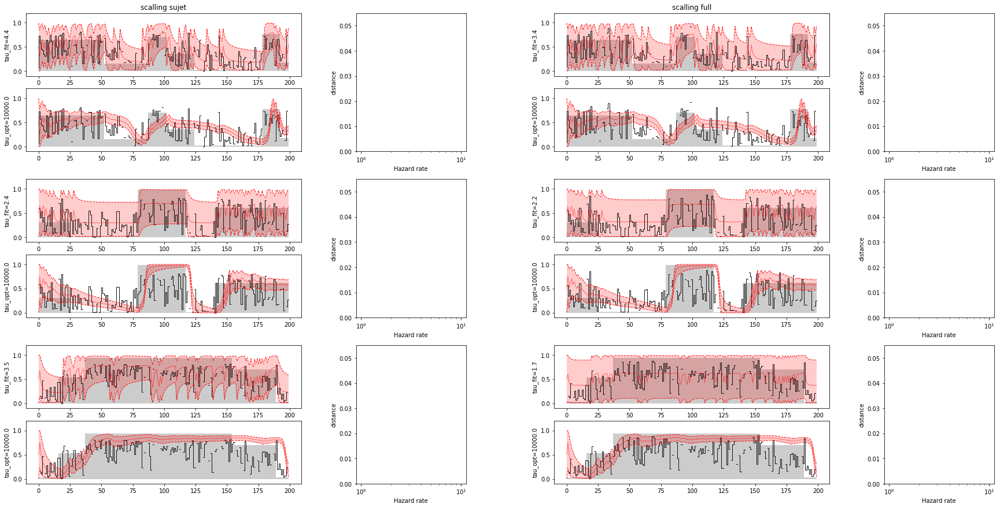

s09

scalling sujet
block 0 --> tau_fit=6.7 , h_fit=0.14841 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=10.0 , h_fit=0.10009 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=619.1 , h_fit=0.00162 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=6.1 , h_fit=0.16506 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.3 , h_fit=0.18697 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=2.7 , h_fit=0.36898 , tau_opt=10000.0 , h_opt=0.00010


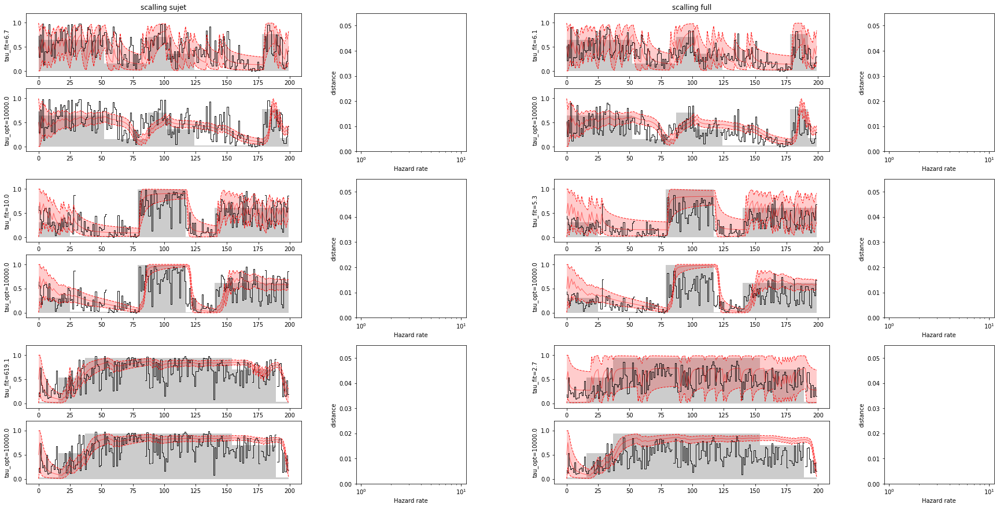

s10

scalling sujet
block 0 --> tau_fit=6.6 , h_fit=0.15103 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.1 , h_fit=0.12282 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=19.0 , h_fit=0.05252 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=10.9 , h_fit=0.09153 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.8 , h_fit=0.11377 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=11.7 , h_fit=0.08573 , tau_opt=10000.0 , h_opt=0.00010


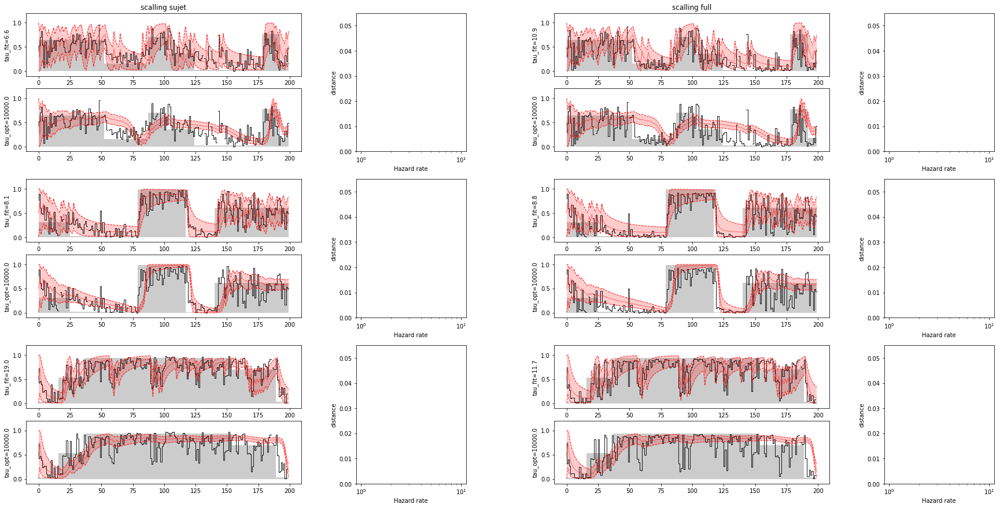

s11

scalling sujet
block 0 --> tau_fit=27.5 , h_fit=0.03639 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=6.4 , h_fit=0.15649 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=9.6 , h_fit=0.10379 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=22.0 , h_fit=0.04541 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=9.0 , h_fit=0.11061 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=9.4 , h_fit=0.10609 , tau_opt=10000.0 , h_opt=0.00010


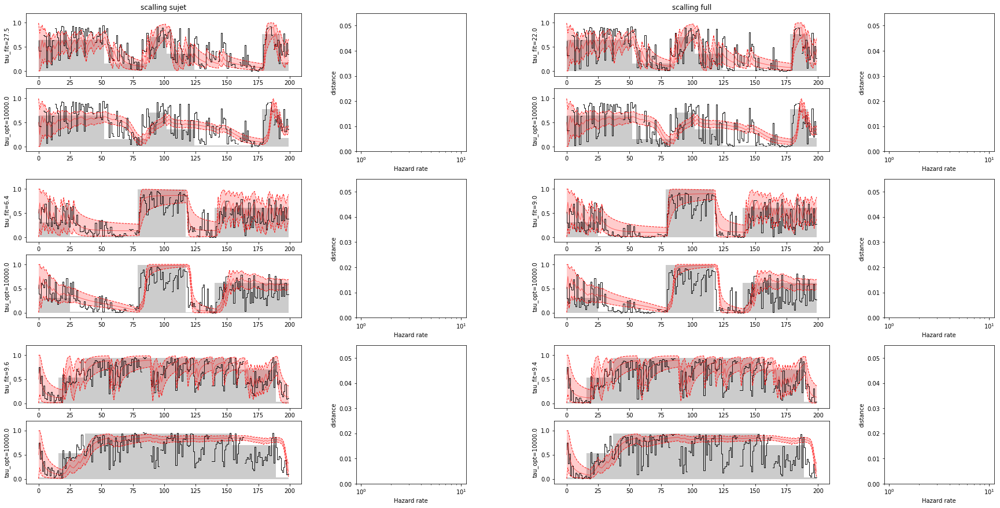

s12

scalling sujet
block 0 --> tau_fit=1.4 , h_fit=0.71627 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=2.8 , h_fit=0.35231 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=2.7 , h_fit=0.36487 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=1.1 , h_fit=0.93477 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=2.7 , h_fit=0.37397 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=3.1 , h_fit=0.31826 , tau_opt=10000.0 , h_opt=0.00010


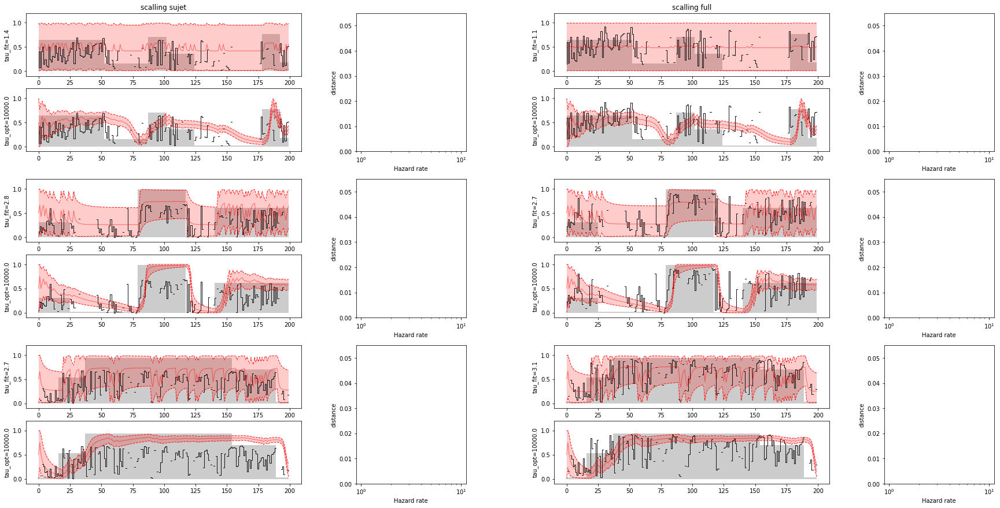

In [16]:
evaluating (new_va_sujet, new_va_full, h_va_sujet, h_va_full)

s01

scalling sujet
block 0
pause 0

/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:17: RuntimeWarning: All-NaN slice encountered
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: RuntimeWarning: All-NaN slice encountered


 --> tau_fit=19.7 , h_fit=0.05065 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=11.5 , h_fit=0.08685 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=63.5 , h_fit=0.01574 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=3.4 , h_fit=0.29522 , tau_opt=3.7 , h_opt=0.27186
block 1
pause 0 --> tau_fit=10.6 , h_fit=0.09466 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=10.5 , h_fit=0.09513 , tau_opt=10.2 , h_opt=0.09770
pause 2 --> tau_fit=4.7 , h_fit=0.21116 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.3 , h_fit=0.79597 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=69.5 , h_fit=0.01440 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=39.5 , h_fit=0.02529 , tau_opt=45.3 , h_opt=0.02205
pause 2 --> tau_fit=83.1 , h_fit=0.01204 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6405.7 , h_fit=0.00016 , tau_opt=2477.1 , h_opt=0.00040

scalling full
block 0
pause 0 --> tau_fit=64.0 , h_fit=0.01562 , tau_opt=10000.0 , h_opt=0.00010
pause

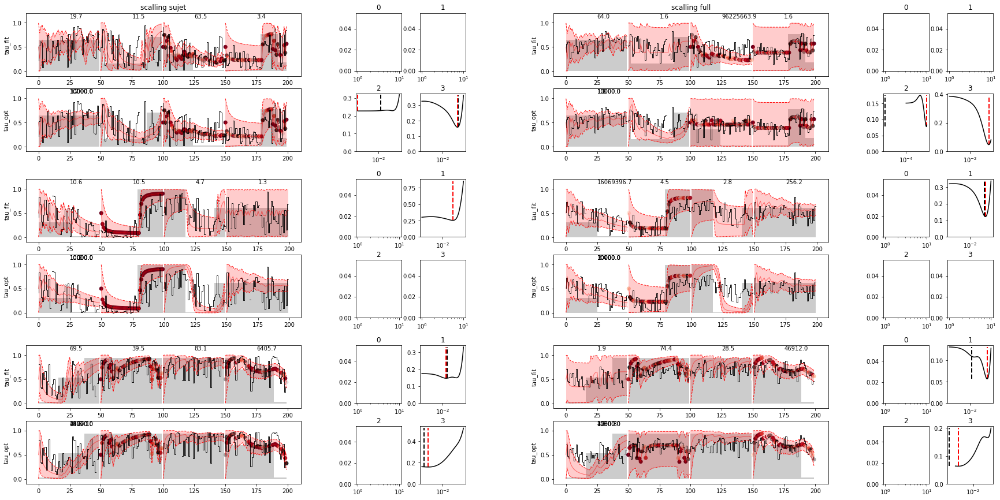

s02

scalling sujet
block 0
pause 0 --> tau_fit=16.0 , h_fit=0.06254 , tau_opt=1.6 , h_opt=0.62803
pause 1 --> tau_fit=3.3 , h_fit=0.30016 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=39717431.7 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=2.9 , h_fit=0.33943 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=77.6 , h_fit=0.01288 , tau_opt=65.8 , h_opt=0.01520
pause 1 --> tau_fit=9.9 , h_fit=0.10120 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=10.0 , h_fit=0.09982 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.3 , h_opt=0.75646
block 2
pause 0 --> tau_fit=3.7 , h_fit=0.27194 , tau_opt=5.9 , h_opt=0.17074
pause 1 --> tau_fit=8.6 , h_fit=0.11693 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=29.1 , h_fit=0.03437 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=47.0 , h_fit=0.02130 , tau_opt=19.6 , h_opt=0.05094

scalling full
block 0
pause 0 --> tau_fit=19.6 , h_fit=0.05097 , tau_opt=

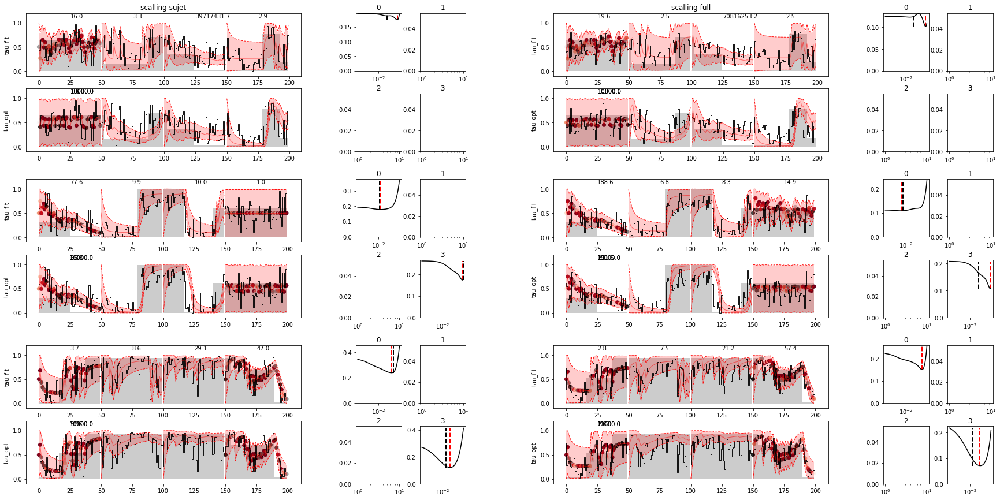

s03

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.36665 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=13.1 , h_fit=0.07630 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=45.5 , h_fit=0.02200 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=970.0 , h_fit=0.00103 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=16.8 , h_fit=0.05945 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=7.1 , h_fit=0.14143 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=11.5 , h_fit=0.08731 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=50.4 , h_fit=0.01984 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=11.5 , h_fit=0.08710 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=20.1 , h_fit=0.04980 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=109.2 , h_fit=0.00916 , tau_opt=8.5 , h_opt=0.11768
pause 3 --> tau_fit=221.3 , h_fit=0.00452 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=22.5 , h_fit=0.04445

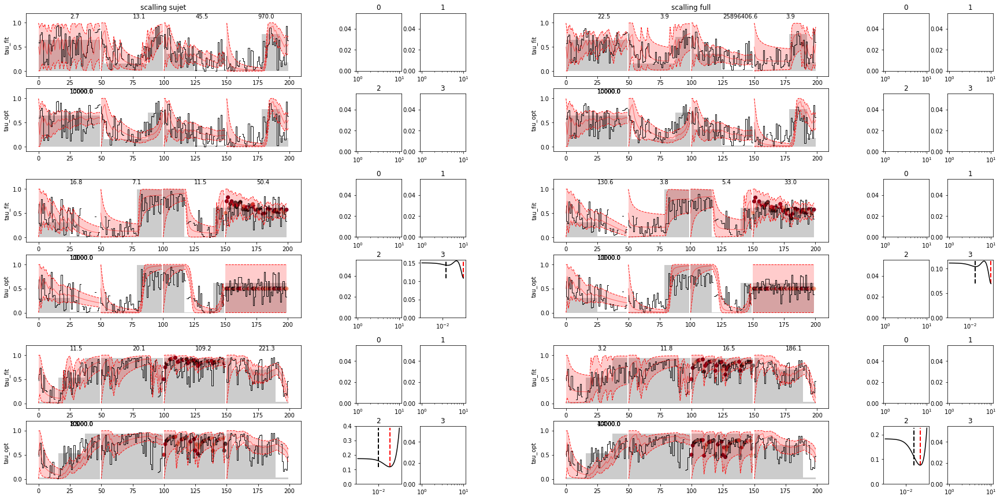

s04

scalling sujet
block 0
pause 0 --> tau_fit=13.3 , h_fit=0.07524 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=15.7 , h_fit=0.06368 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=3.7 , h_fit=0.27343 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=13.6 , h_fit=0.07376 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=4.7 , h_fit=0.21413 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=13.1 , h_fit=0.07658 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=5.7 , h_fit=0.17426 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.3 , h_fit=0.74127 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=7.6 , h_fit=0.13232 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=4.1 , h_fit=0.24355 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=15.9 , h_fit=0.06306 , tau_opt=6.4 , h_opt=0.15557
pause 3 --> tau_fit=6.7 , h_fit=0.14854 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=16.1 , h_fit=0.06197 , t

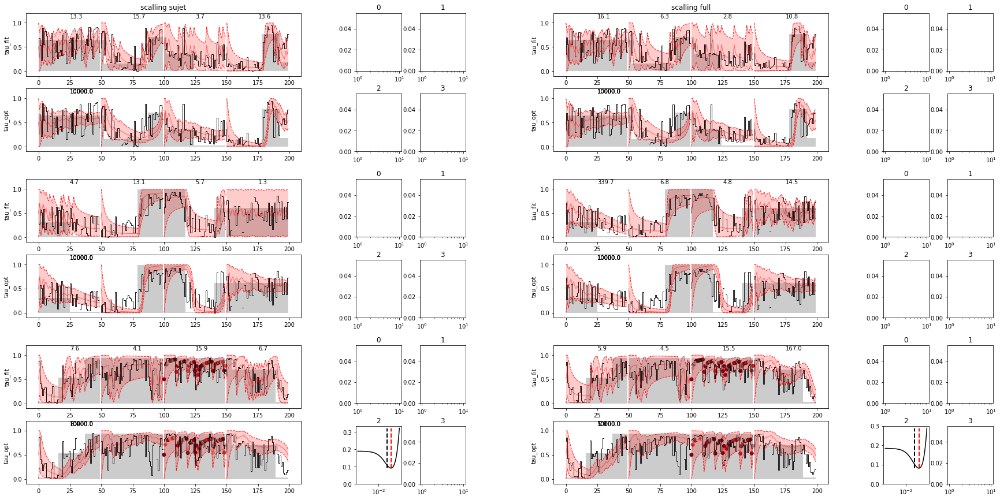

s05

scalling sujet
block 0
pause 0 --> tau_fit=721.4 , h_fit=0.00139 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=4.3 , h_fit=0.23057 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=22850073.8 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.5 , h_fit=0.15402 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=13.9 , h_fit=0.07193 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=3.0 , h_fit=0.33658 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=8.2 , h_fit=0.12245 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=150.9 , h_fit=0.00663 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=1979.4 , h_fit=0.00051 , tau_opt=6280.3 , h_opt=0.00016
pause 1 --> tau_fit=38.3 , h_fit=0.02613 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=15.4 , h_fit=0.06511 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=9.0 , h_fit=0.11081 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=10.3 , h_

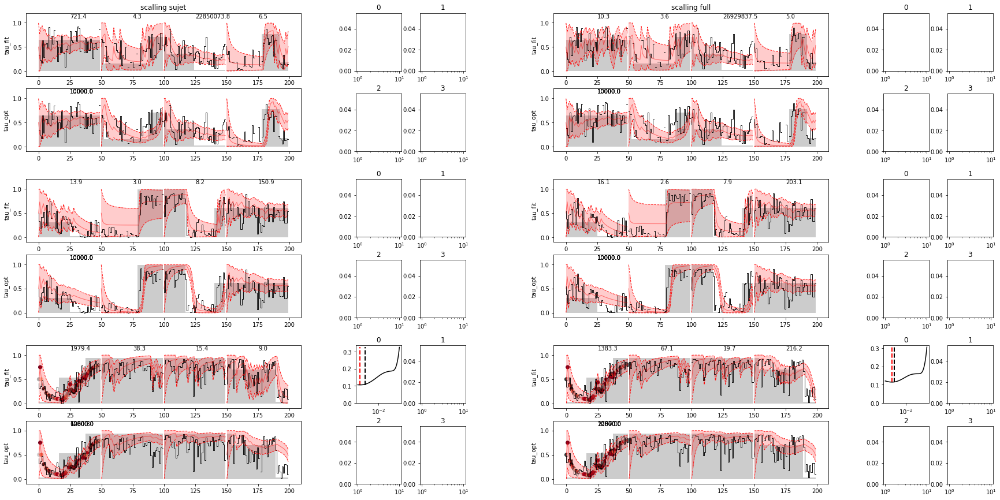

s06

scalling sujet
block 0
pause 0 --> tau_fit=9.2 , h_fit=0.10873 , tau_opt=9.3 , h_opt=0.10723
pause 1 --> tau_fit=35.8 , h_fit=0.02796 , tau_opt=2.8 , h_opt=0.35938
pause 2 --> tau_fit=19.3 , h_fit=0.05172 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.6 , h_fit=0.15112 , tau_opt=5.9 , h_opt=0.17074
block 1
pause 0 --> tau_fit=20.7 , h_fit=0.04827 , tau_opt=17.9 , h_opt=0.05591
pause 1 --> tau_fit=7.4 , h_fit=0.13468 , tau_opt=9.3 , h_opt=0.10723
pause 2 --> tau_fit=7.4 , h_fit=0.13456 , tau_opt=4.4 , h_opt=0.22570
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=3.6 , h_fit=0.27752 , tau_opt=7.7 , h_opt=0.12915
pause 1 --> tau_fit=18.9 , h_fit=0.05305 , tau_opt=59.9 , h_opt=0.01668
pause 2 --> tau_fit=68.7 , h_fit=0.01455 , tau_opt=49.8 , h_opt=0.02009
pause 3 --> tau_fit=599.7 , h_fit=0.00167 , tau_opt=5.9 , h_opt=0.17074

scalling full
block 0
pause 0 --> tau_fit=9.9 , h_fit=0.10069 , tau_opt=11.2 , h_opt=0.08902
paus

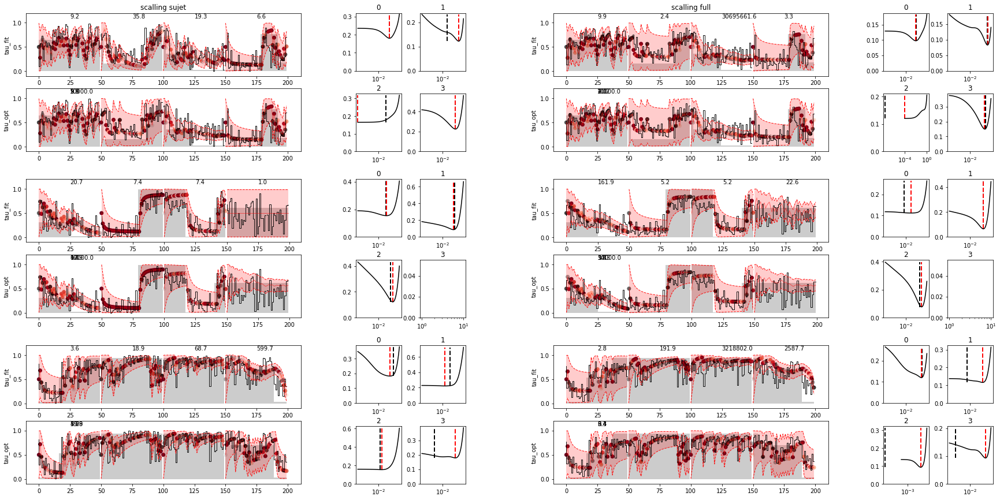

s07

scalling sujet
block 0
pause 0 --> tau_fit=15.2 , h_fit=0.06569 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=9.0 , h_fit=0.11145 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=58.7 , h_fit=0.01703 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4.8 , h_fit=0.20957 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=10.5 , h_fit=0.09511 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=7.0 , h_fit=0.14220 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=6.5 , h_fit=0.15396 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.6 , h_fit=0.63588 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=20.7 , h_fit=0.04837 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=41.3 , h_fit=0.02422 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=12.2 , h_fit=0.08178 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=16.0 , h_fit=0.06248 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=13.2 , h_fit=0.075

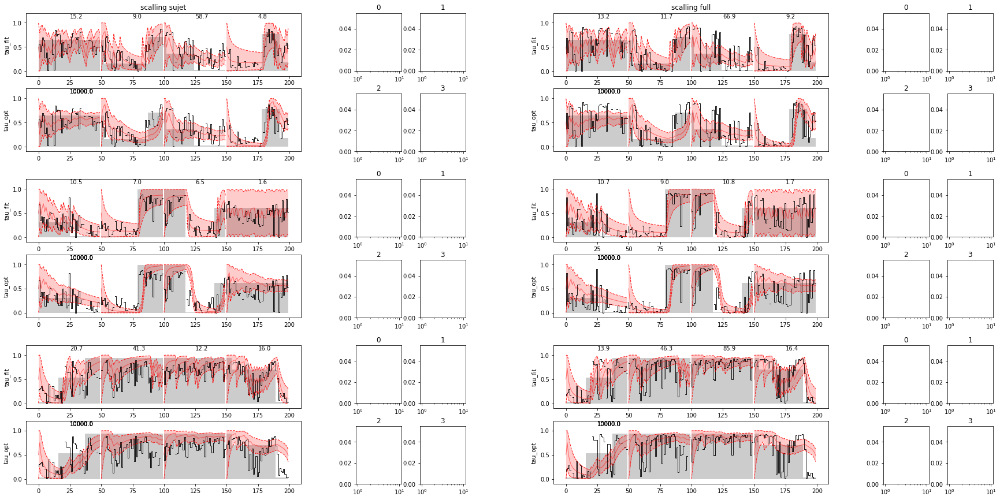

s08

scalling sujet
block 0
pause 0 --> tau_fit=10.4 , h_fit=0.09610 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=4.5 , h_fit=0.22444 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.2 , h_fit=0.45266 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.1 , h_fit=0.16409 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=363.9 , h_fit=0.00275 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.0 , h_fit=0.49094 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.6 , h_fit=0.38453 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=19.8 , h_fit=0.05039 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=10.4 , h_fit=0.09650 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.3 , h_fit=0.42666 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.5 , h_fit=0.39998 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=31.1 , h_fit=0.03217 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=24.2 , h_fit=0.0413

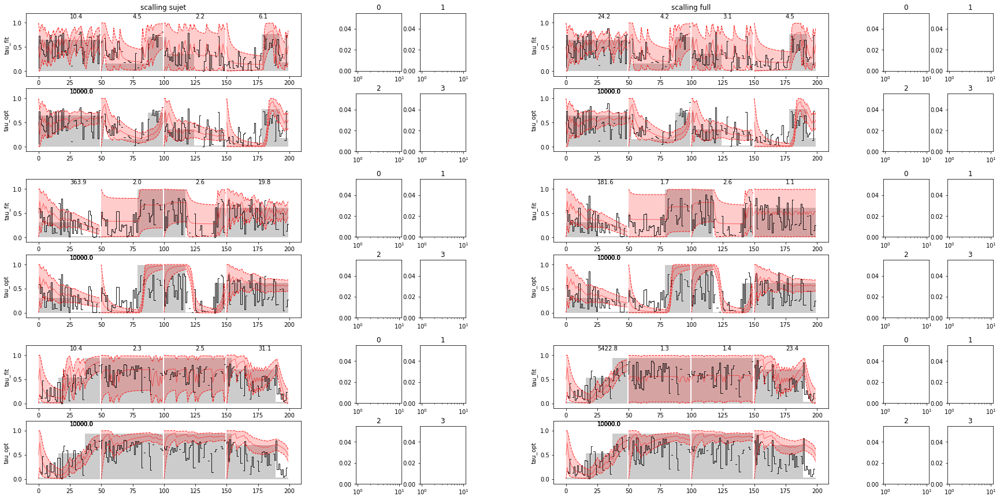

s09

scalling sujet
block 0
pause 0 --> tau_fit=11.3 , h_fit=0.08887 , tau_opt=21.5 , h_opt=0.04642
pause 1 --> tau_fit=193.2 , h_fit=0.00517 , tau_opt=2.3 , h_opt=0.43288
pause 2 --> tau_fit=2.3 , h_fit=0.42760 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=13.5 , h_fit=0.07432 , tau_opt=10.2 , h_opt=0.09770
block 1
pause 0 --> tau_fit=22.2 , h_fit=0.04506 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=6.1 , h_fit=0.16427 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=6.0 , h_fit=0.16571 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=197.8 , h_fit=0.00506 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=121.7 , h_fit=0.00821 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=178.1 , h_fit=0.00561 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=10.4 , h_fit=0.09586 , tau_opt=6.4 , h_opt=0.15557
pause 3 --> tau_fit=793.6 , h_fit=0.00126 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=28.0 , h_fit=0.03565 , tau_op

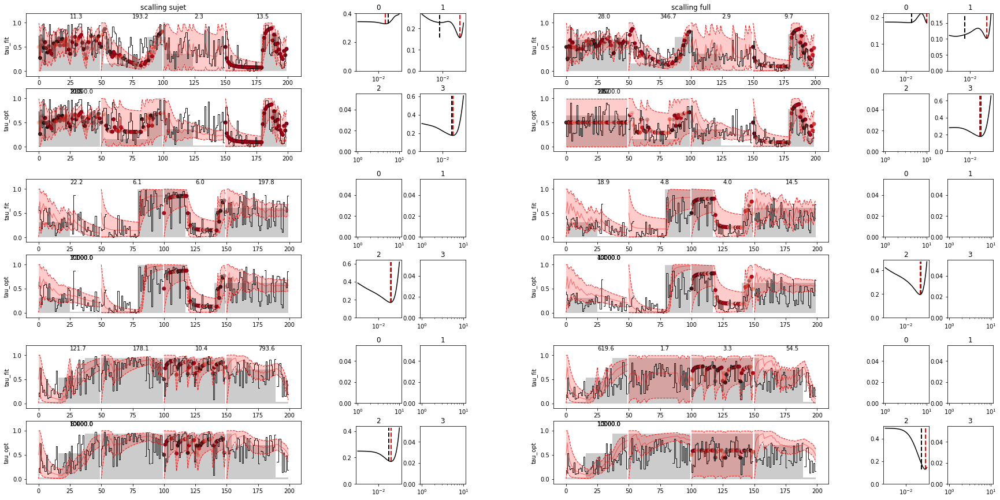

s10

scalling sujet
block 0
pause 0 --> tau_fit=92.2 , h_fit=0.01085 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.9 , h_fit=0.34956 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=3.4 , h_fit=0.29780 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.2 , h_fit=0.16047 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=10.1 , h_fit=0.09911 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=10.0 , h_fit=0.10041 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=9.3 , h_fit=0.10745 , tau_opt=13.5 , h_opt=0.07391
pause 3 --> tau_fit=5.8 , h_fit=0.17168 , tau_opt=3.7 , h_opt=0.27186
block 2
pause 0 --> tau_fit=24.4 , h_fit=0.04096 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=26.2 , h_fit=0.03817 , tau_opt=7.1 , h_opt=0.14175
pause 2 --> tau_fit=23.8 , h_fit=0.04208 , tau_opt=10.2 , h_opt=0.09770
pause 3 --> tau_fit=77.5 , h_fit=0.01290 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=207.5 , h_fit=0.00482 , tau_opt=10000.0

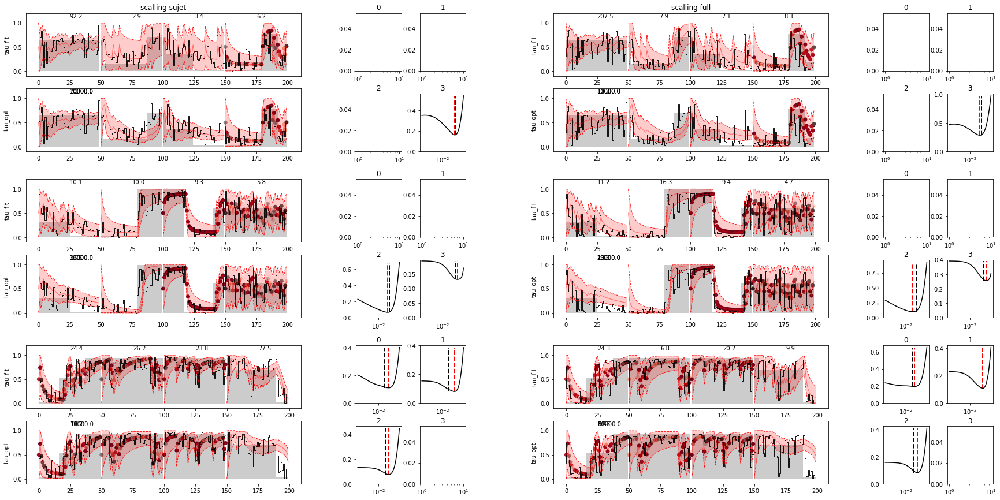

s11

scalling sujet
block 0
pause 0 --> tau_fit=10807788.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=31.2 , h_fit=0.03210 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=1.5 , h_fit=0.66633 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=11.2 , h_fit=0.08946 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=77.4 , h_fit=0.01292 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=14.1 , h_fit=0.07103 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=5.8 , h_fit=0.17211 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4.8 , h_fit=0.20805 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=13.1 , h_fit=0.07661 , tau_opt=87.0 , h_opt=0.01150
pause 1 --> tau_fit=12.0 , h_fit=0.08347 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=9.3 , h_fit=0.10722 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=8.5 , h_fit=0.11723 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=4895473.6 , h_fit=0

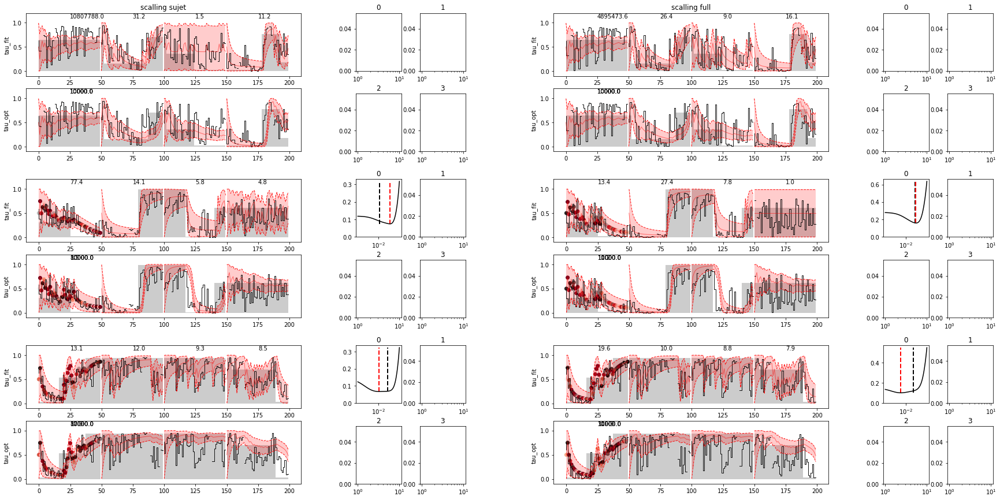

s12

scalling sujet
block 0
pause 0 --> tau_fit=21.1 , h_fit=0.04746 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.1 , h_fit=0.47899 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=40212345.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=22481536.1 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=3.2 , h_fit=0.31705 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.8 , h_fit=0.35195 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=2.3 , h_fit=0.43163 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=4.1 , h_fit=0.24276 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.5 , h_fit=0.40497 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=439.6 , h_fit=0.00227 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=11.0 , h

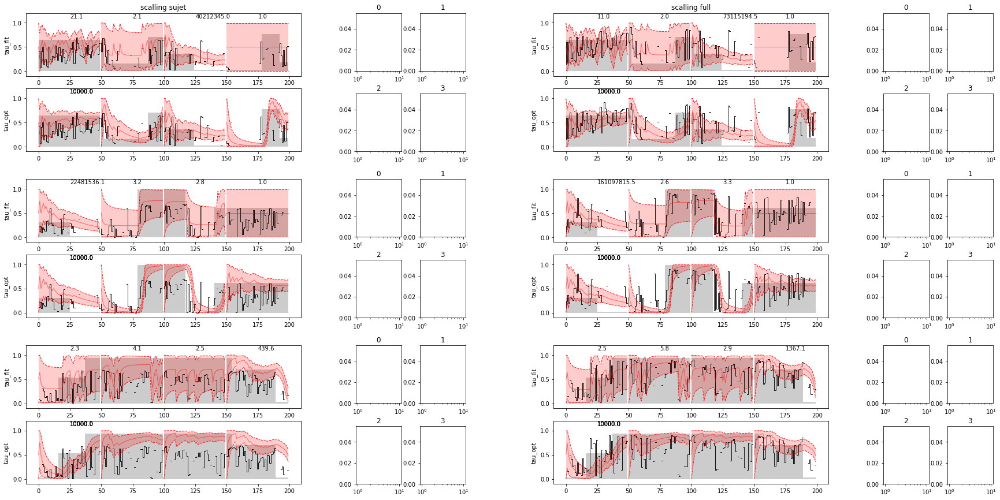

In [17]:
evaluating (new_va_sujet, new_va_full, h_va_sujet, h_va_full, show='h_pause')